In [1]:
# Import the required libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from time import time


from sklearn.metrics import log_loss
from sklearn.tree import DecisionTreeClassifier, export_graphviz
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.metrics import accuracy_score
from sklearn.tree import DecisionTreeClassifier
from sklearn.preprocessing import MaxAbsScaler
import plotly.express as px
import warnings
warnings.filterwarnings('ignore', category=UserWarning)
import six


#!pip install pydot

# For the tree visualization
import pydot
from IPython.display import Image
from six import StringIO
from sklearn.tree import export_graphviz

In [2]:
# Mapping of activity codes to human-readable activity names
activity_codes_mapping = {
    'A': 'walking',
    'B': 'jogging',
    'C': 'stairs',
    'D': 'sitting',
    'E': 'standing',
    'F': 'typing',
    'G': 'brushing teeth',
    'H': 'eating soup',
    'I': 'eating chips',
    'J': 'eating pasta',
    'K': 'drinking from cup',
    'L': 'eating sandwich',
    'M': 'kicking soccer ball',
    'O': 'playing catch tennis ball',
    'P': 'dribbling basket ball',
    'Q': 'writing',
    'R': 'clapping',
    'S': 'folding clothes'
}

# Mapping of activity names to colors for visualization
activity_color_map = {
    activity_codes_mapping['A']: 'lime',
    activity_codes_mapping['B']: 'red',
    activity_codes_mapping['C']: 'blue',
    activity_codes_mapping['D']: 'orange',
    activity_codes_mapping['E']: 'yellow',
    activity_codes_mapping['F']: 'lightgreen',
    activity_codes_mapping['G']: 'greenyellow',
    activity_codes_mapping['H']: 'magenta',
    activity_codes_mapping['I']: 'gold',
    activity_codes_mapping['J']: 'cyan',
    activity_codes_mapping['K']: 'purple',
    activity_codes_mapping['L']: 'lightgreen',
    activity_codes_mapping['M']: 'violet',
    activity_codes_mapping['O']: 'limegreen',
    activity_codes_mapping['P']: 'deepskyblue',   
    activity_codes_mapping['Q']: 'mediumspringgreen',
    activity_codes_mapping['R']: 'plum',
    activity_codes_mapping['S']: 'olive'
}


In [3]:
def show_accel_per_activity(device, df, act, interval_in_sec=None):
    ''' 
    Plots acceleration time history per activity.
    
    Parameters:
        device (str): The device name.
        df (DataFrame): The DataFrame containing accelerometer data.
        act (str): The activity to plot acceleration for.
        interval_in_sec (int, optional): Interval in seconds to limit the plotted data.

    Returns:
        None
    '''
    # Select data for the specified activity
    df1 = df.loc[df.activity == act].copy()
    df1.reset_index(drop=True, inplace=True)

    # Calculate duration in seconds
    df1['duration'] = (df1['timestamp'] - df1['timestamp'].iloc[0]) / 1000000000  # nanoseconds --> seconds

    if interval_in_sec is None:
        # Plot full data if no interval is specified
        ax = df1[:].plot(kind='line', x='duration', y=['x', 'y', 'z'], figsize=(25, 7), grid=True)
    else:
        # Plot data within the specified interval
        ax = df1[:interval_in_sec * 20].plot(kind='line', x='duration', y=['x', 'y', 'z'], figsize=(25, 7), grid=True)

    # Set labels and title
    ax.set_xlabel('duration  (sec)', fontsize=15)
    ax.set_ylabel('acceleration  (m/sec^2)', fontsize=15)
    ax.set_title('Acceleration:   Device: ' + device + '      Activity:  ' + act, fontsize=15)


In [4]:
def show_ang_velocity_per_activity(device, df, act, interval_in_sec=None):
    ''' 
    Plots angular velocity time history per activity.
    
    Parameters:
        device (str): The device name.
        df (DataFrame): The DataFrame containing angular velocity data.
        act (str): The activity to plot angular velocity for.
        interval_in_sec (int, optional): Interval in seconds to limit the plotted data.

    Returns:
        None
    '''
    # Select data for the specified activity
    df1 = df.loc[df.activity == act].copy()
    df1.reset_index(drop=True, inplace=True)

    # Calculate duration in seconds
    df1['duration'] = (df1['timestamp'] - df1['timestamp'].iloc[0]) / 1000000000  # nanoseconds --> seconds

    if interval_in_sec is None:
        # Plot full data if no interval is specified
        ax = df1[:].plot(kind='line', x='duration', y=['x', 'y', 'z'], figsize=(25, 7), grid=True)
    else:
        # Plot data within the specified interval
        ax = df1[:interval_in_sec * 20].plot(kind='line', x='duration', y=['x', 'y', 'z'], figsize=(25, 7), grid=True)

    # Set labels and title
    ax.set_xlabel('duration  (sec)', fontsize=15)
    ax.set_ylabel('angular velocity  (rad/sec)', fontsize=15)
    ax.set_title('Angular velocity:  Device: ' + device + '      Activity:  ' + act, fontsize=15)


# Phone Acceleration measurment data

In [5]:
# Read accelerometer data from file into a DataFrame
raw_par_10_phone_accel = pd.read_csv('C:/Users/25858831/Downloads/wisdm-dataset/wisdm-dataset/raw/phone/accel/data_1600_accel_phone.txt', names = ['participant_id' , 'activity_code' , 'timestamp', 'x', 'y', 'z'], index_col=None, header=None)

# Remove any trailing semicolons and convert 'z' column to numeric
raw_par_10_phone_accel.z = raw_par_10_phone_accel.z.str.strip(';')
raw_par_10_phone_accel.z = pd.to_numeric(raw_par_10_phone_accel.z)

# Map activity codes to human-readable activity names
raw_par_10_phone_accel['activity'] = raw_par_10_phone_accel['activity_code'].map(activity_codes_mapping)

# Reorder columns for better readability
raw_par_10_phone_accel = raw_par_10_phone_accel[['participant_id', 'activity_code', 'activity', 'timestamp', 'x', 'y', 'z']]

# Display the resulting DataFrame
raw_par_10_phone_accel

,participant_id,activity_code,activity,timestamp,x,y,z
0,1600,A,walking,252207666810782,-0.364761,8.793503,1.055084
1,1600,A,walking,252207717164786,-0.879730,9.768784,1.016998
2,1600,A,walking,252207767518790,2.001495,11.109070,2.619156
3,1600,A,walking,252207817872794,0.450623,12.651642,0.184555
4,1600,A,walking,252207868226798,-2.164352,13.928436,-4.422485
...,...,...,...,...,...,...,...
64306,1600,S,folding clothes,244505660942200,-2.372223,9.242722,-1.588287
64307,1600,S,folding clothes,244505711296204,-2.046921,10.032288,-1.229935
64308,1600,S,folding clothes,244505761650208,-1.393539,9.883896,-0.479248
64309,1600,S,folding clothes,244505812004212,-1.230454,9.315079,-0.155701


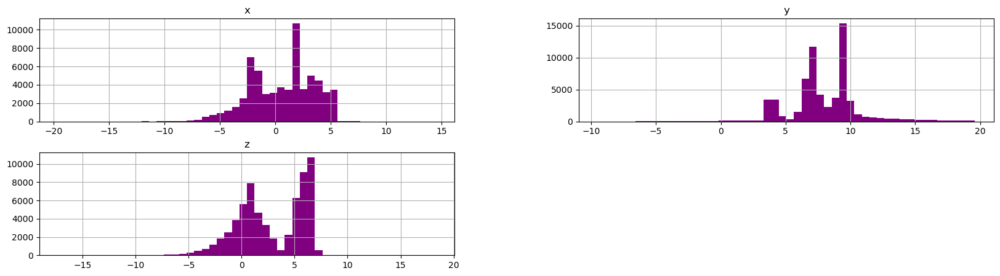

In [6]:
# Use the entire accelerometer data
T = raw_par_10_phone_accel
# Plot histograms of accelerometer data for x, y, and z axes
_ = T[['x', 'y', 'z']].hist(bins = 50, figsize = (20, 5), color='purple')
#T.hist(column='x', by='activity')

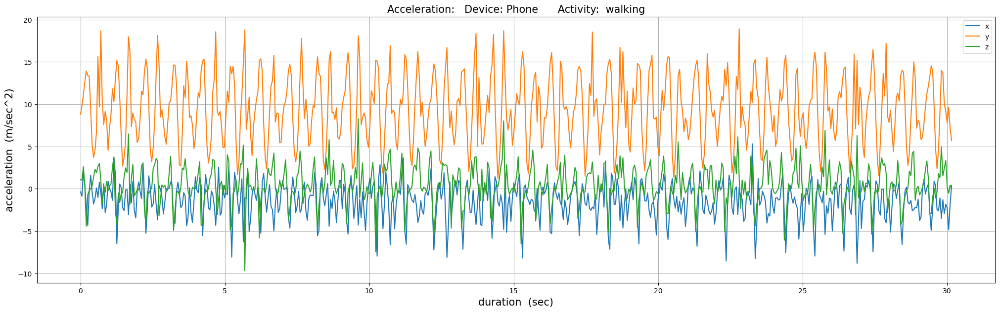

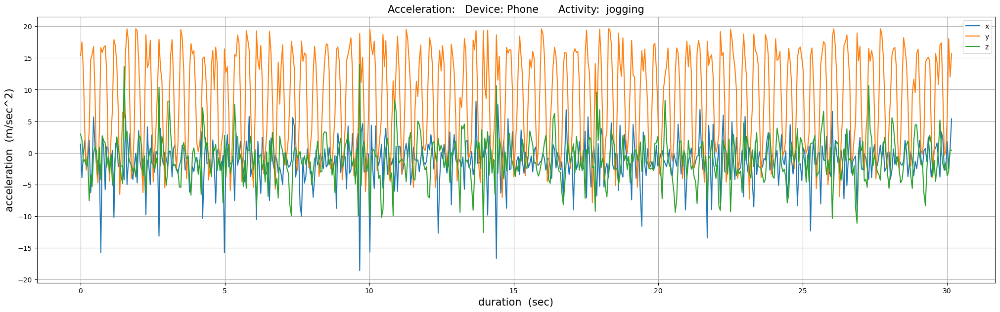

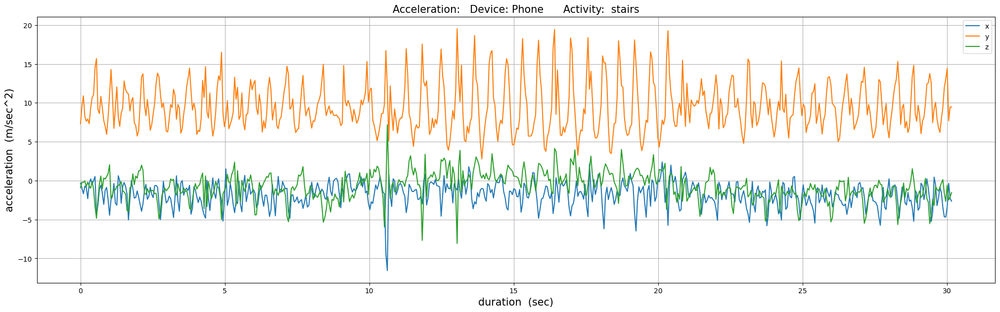

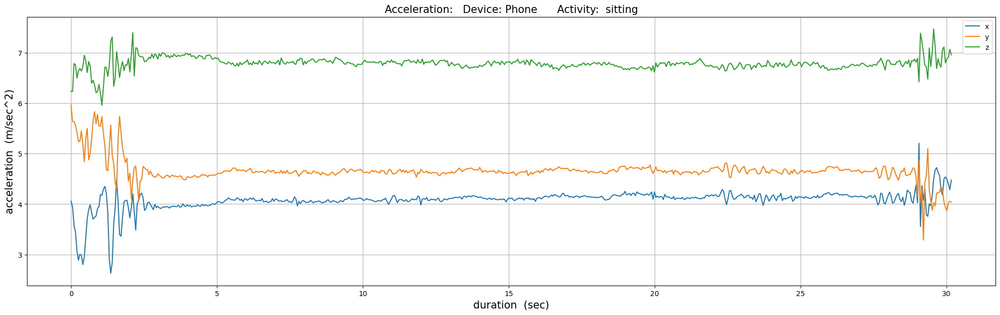

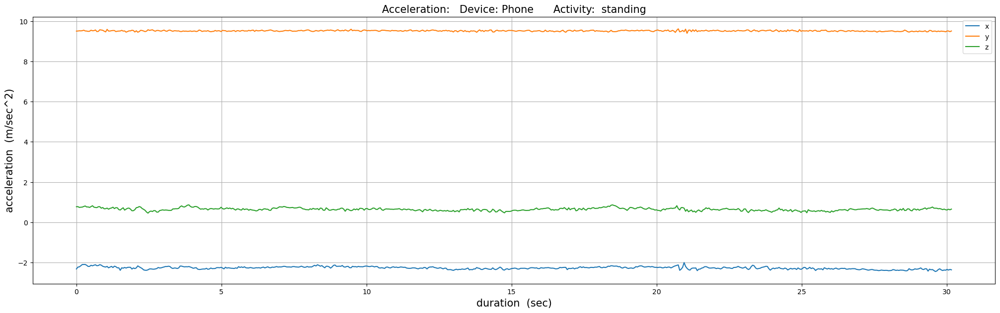

...

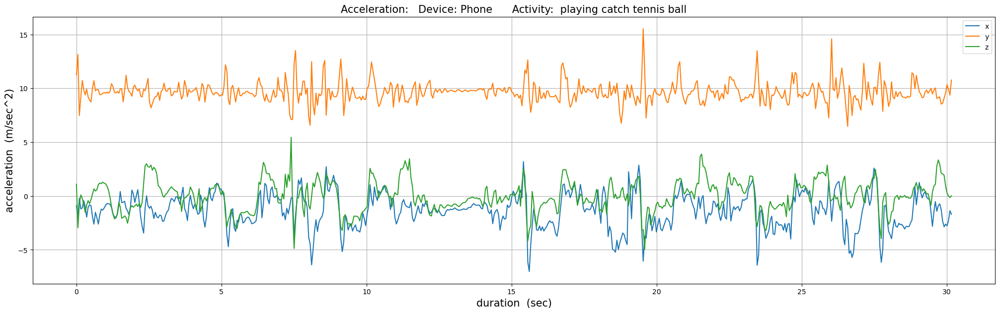

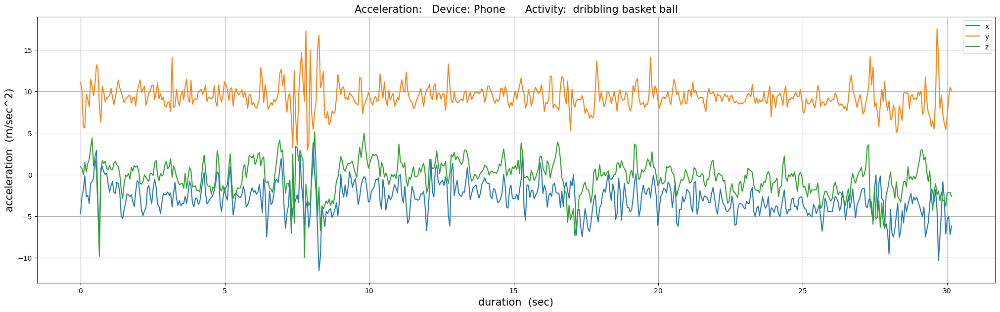

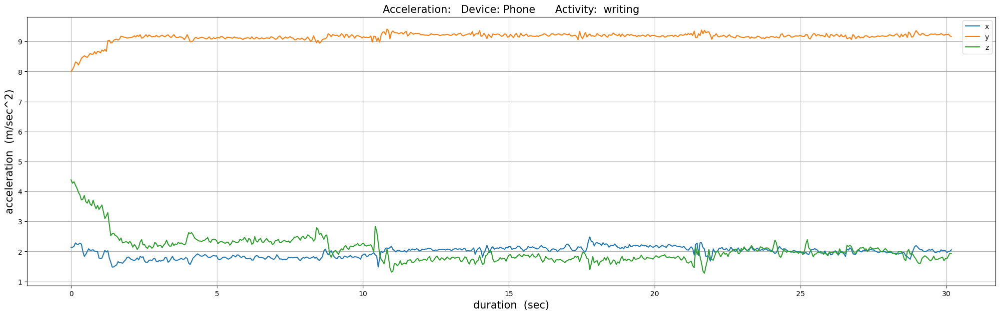

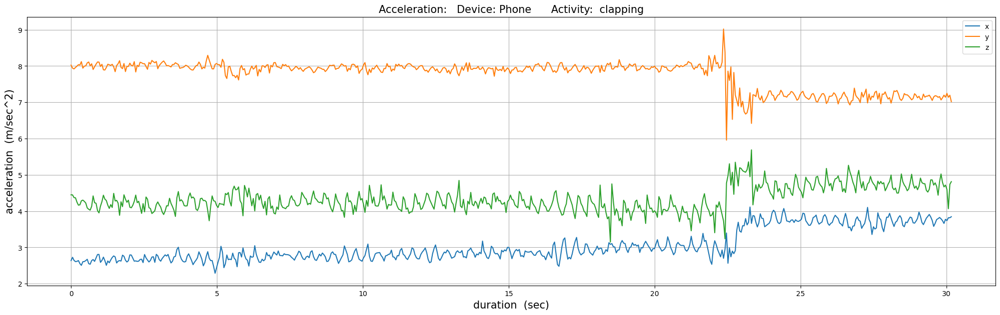

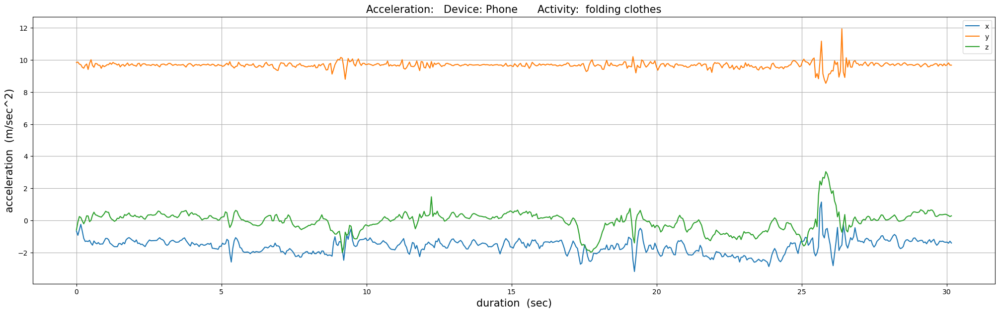

In [7]:
# Iterate over each activity code in the activity_codes_mapping dictionary
for key in activity_codes_mapping:
    # Call the show_accel_per_activity function to plot acceleration data
    # Parameters: device='Phone', df=raw_par_10_phone_accel (accelerometer data),
    # act=activity_codes_mapping[key] (activity name corresponding to the current activity code),
    # interval_in_sec=30 (plot data for 10 seconds interval)
    show_accel_per_activity('Phone', raw_par_10_phone_accel, activity_codes_mapping[key], 30)


# Watch Acceleration measurment data

In [8]:
# Read accelerometer data from file into a DataFrame
raw_par_20_watch_accel = pd.read_csv('C:/Users/25858831/Downloads/wisdm-dataset/wisdm-dataset/raw/watch/accel/data_1602_accel_watch.txt', names = ['participant_id' , 'activity_code' , 'timestamp', 'x', 'y', 'z'], index_col=None, header=None)

# Read accelerometer data from file into a DataFrame
raw_par_20_watch_accel.z = raw_par_20_watch_accel.z.str.strip(';')
raw_par_20_watch_accel.z = pd.to_numeric(raw_par_20_watch_accel.z)

# Map activity codes to human-readable activity names
raw_par_20_watch_accel['activity'] = raw_par_20_watch_accel['activity_code'].map(activity_codes_mapping)

# Reorder columns for better readability
raw_par_20_watch_accel = raw_par_20_watch_accel[['participant_id', 'activity_code', 'activity', 'timestamp', 'x', 'y', 'z']]

# Display the resulting DataFrame
raw_par_20_watch_accel

,participant_id,activity_code,activity,timestamp,x,y,z
0,1602,A,walking,522177037620822,1.113154,-3.663428,8.803629
1,1602,A,walking,522177087120822,0.670227,-2.885312,7.630470
2,1602,A,walking,522177136620822,0.229694,-2.356194,7.584981
3,1602,A,walking,522177186120822,0.167444,-2.152687,7.448511
4,1602,A,walking,522177235620822,0.191386,-1.532588,8.133253
...,...,...,...,...,...,...,...
64980,1602,S,folding clothes,525527108147662,3.095104,-19.342007,10.161141
64981,1602,S,folding clothes,525527158077562,0.777517,-17.292570,5.513996
64982,1602,S,folding clothes,525527208007462,1.488595,-7.323115,5.114164
64983,1602,S,folding clothes,525527257937362,-0.651821,-1.567454,0.392799


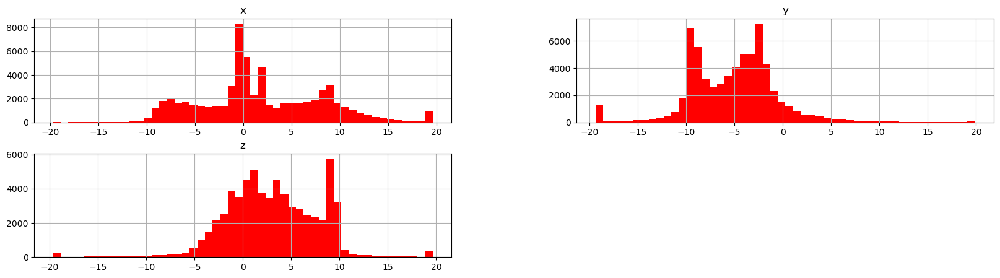

In [9]:
# Select the first 200 rows of the accelerometer data (optional)
# T = raw_par_20_watch_accel.iloc[:200]

# Use the entire accelerometer data
T = raw_par_20_watch_accel

# Plot histograms of accelerometer data for x, y, and z axes with blue color
_ = T[['x', 'y', 'z']].hist(bins=50, figsize=(20, 5), color='red')


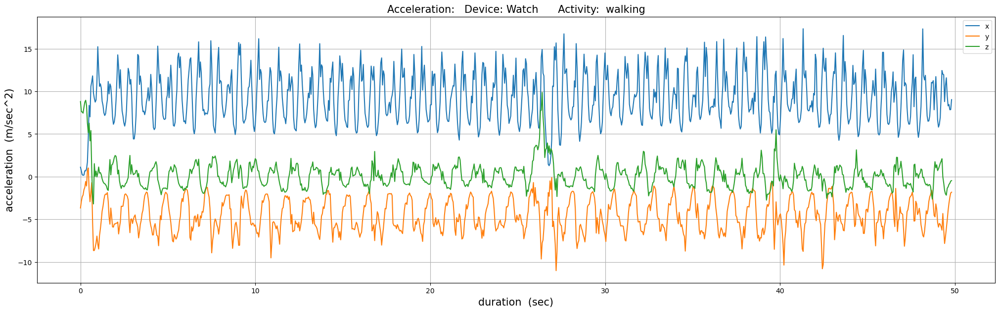

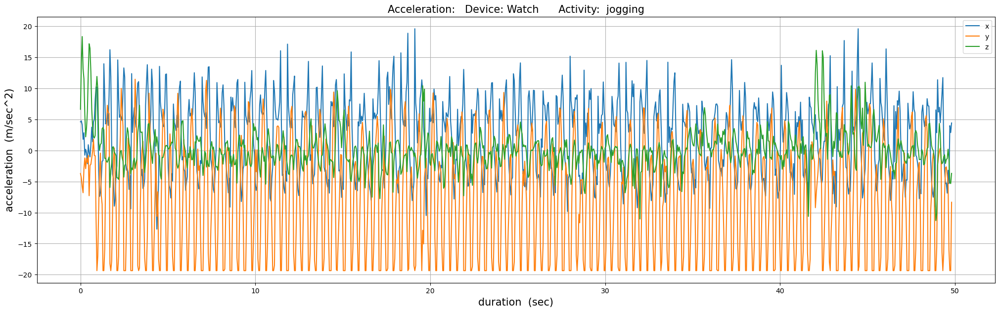

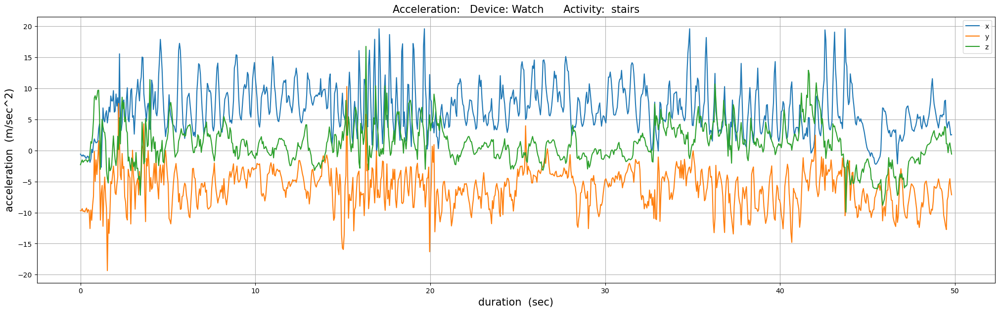

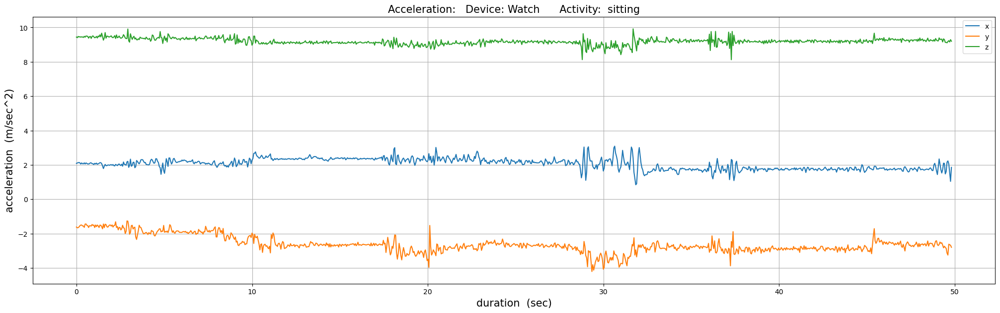

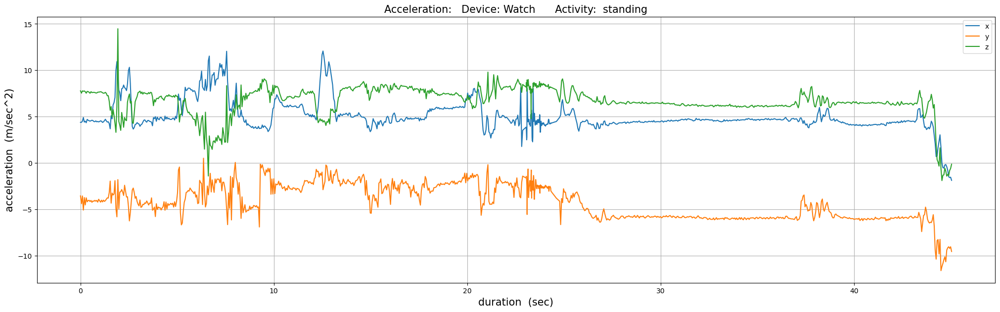

...

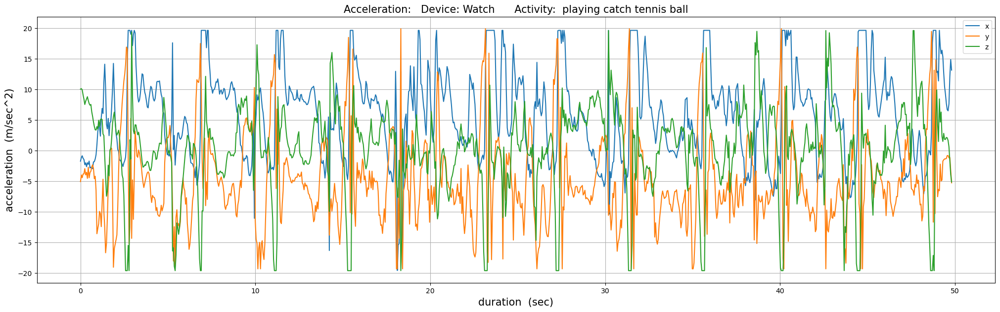

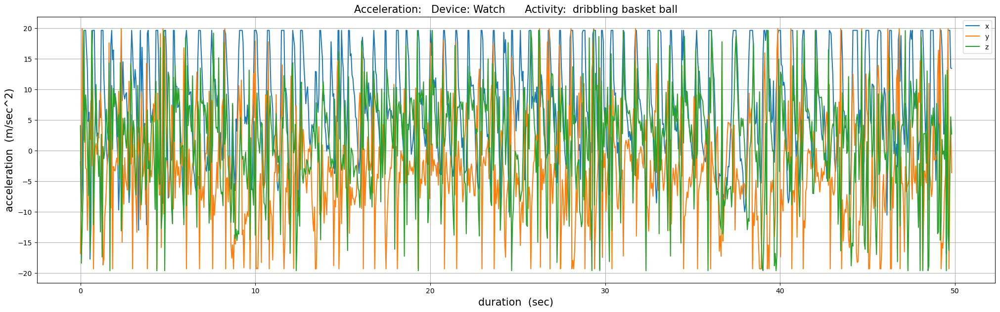

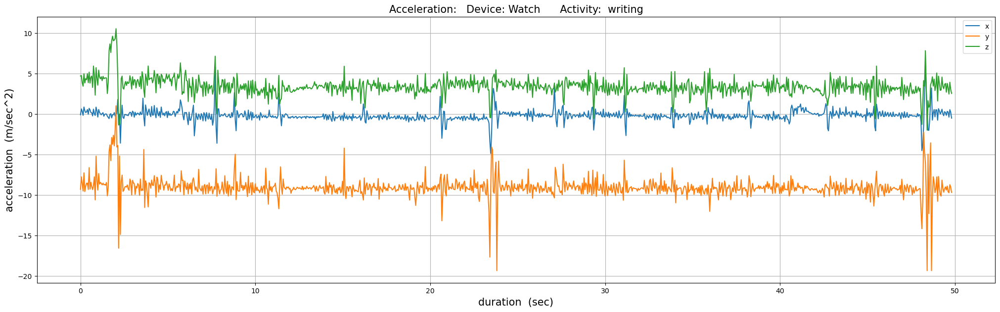

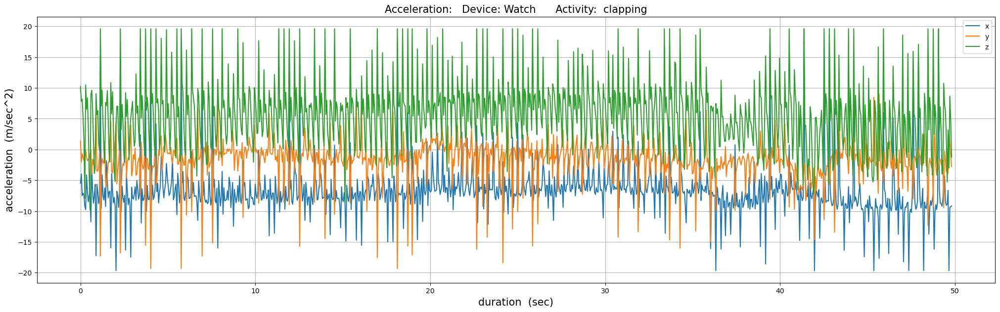

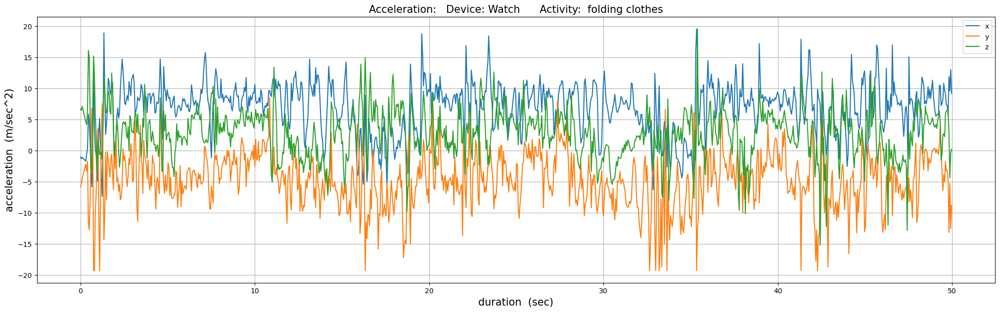

In [10]:
# Iterate over each activity code in the activity_codes_mapping dictionary
for key in activity_codes_mapping:
    # Call the show_accel_per_activity function to plot acceleration data
    # Parameters: device='Watch', df=raw_par_20_watch_accel (accelerometer data),
    # act=activity_codes_mapping[key] (activity name corresponding to the current activity code),
    # interval_in_sec=50 (plot data for 50 seconds interval)
    show_accel_per_activity('Watch', raw_par_20_watch_accel, activity_codes_mapping[key], 50)

# Phone Angualr Velocity Measurment Data

In [11]:
# Read gyroscope data from file into a DataFrame
raw_par_35_phone_ang_vel = pd.read_csv('C:/Users/25858831/Downloads/wisdm-dataset/wisdm-dataset/raw/phone/gyro/data_1635_gyro_phone.txt',
                                       names=['participant_id', 'activity_code', 'timestamp', 'x', 'y', 'z'],
                                       index_col=None, header=None)

# Remove any trailing semicolons and convert 'z' column to numeric
raw_par_35_phone_ang_vel.z = raw_par_35_phone_ang_vel.z.str.strip(';')
raw_par_35_phone_ang_vel.z = pd.to_numeric(raw_par_35_phone_ang_vel.z)

# Map activity codes to human-readable activity names
raw_par_35_phone_ang_vel['activity'] = raw_par_35_phone_ang_vel['activity_code'].map(activity_codes_mapping)

# Reorder columns for better readability
raw_par_35_phone_ang_vel = raw_par_35_phone_ang_vel[['participant_id', 'activity_code', 'activity', 'timestamp', 'x', 'y', 'z']]

# Display the resulting DataFrame
raw_par_35_phone_ang_vel


,participant_id,activity_code,activity,timestamp,x,y,z
0,1635,A,walking,676165107876419,0.874725,-0.098099,0.807510
1,1635,A,walking,676165158230423,0.563431,-1.359665,1.432419
2,1635,A,walking,676165208584427,1.507690,-3.086883,0.679016
3,1635,A,walking,676165258938431,1.430603,-1.860306,0.451035
4,1635,A,walking,676165309292435,0.325165,-1.735611,0.252365
...,...,...,...,...,...,...,...
64530,1635,S,folding clothes,680277872380268,-0.119614,-0.032928,0.129654
64531,1635,S,folding clothes,680277922750286,-0.500427,-0.465652,0.098923
64532,1635,S,folding clothes,680277973104290,-0.768646,-0.448929,0.063583
64533,1635,S,folding clothes,680278023458294,-0.786408,-0.346924,0.099899


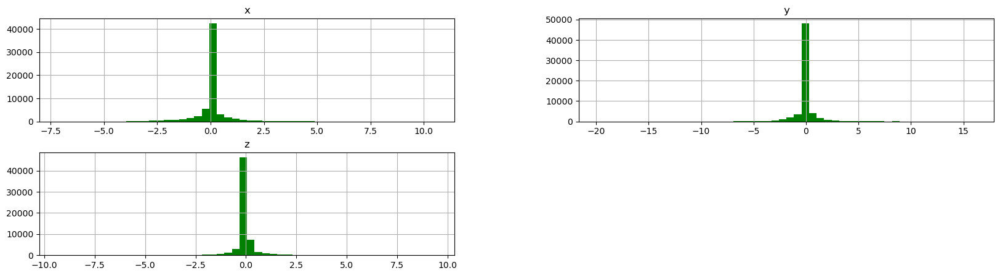

In [12]:
T = raw_par_35_phone_ang_vel
_ = T[['x', 'y', 'z']].hist(bins = 50, figsize = (20, 5), color='green')

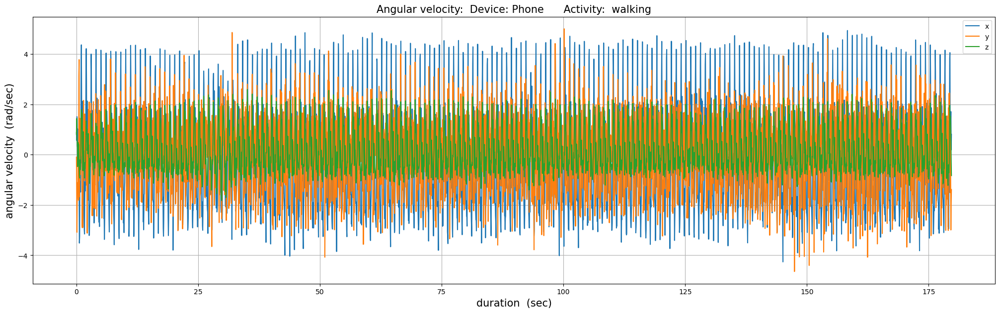

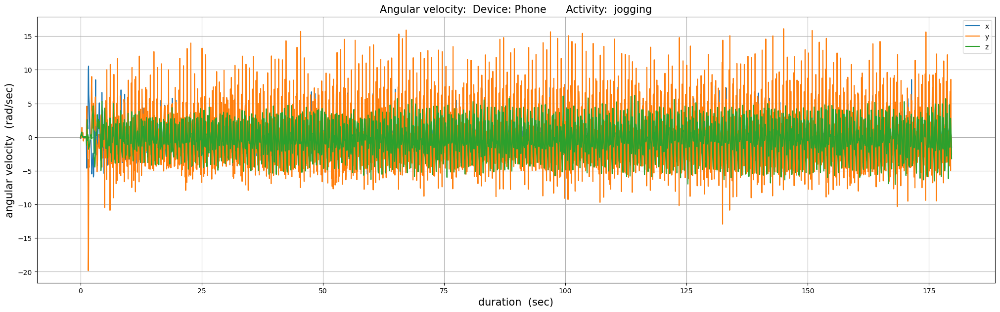

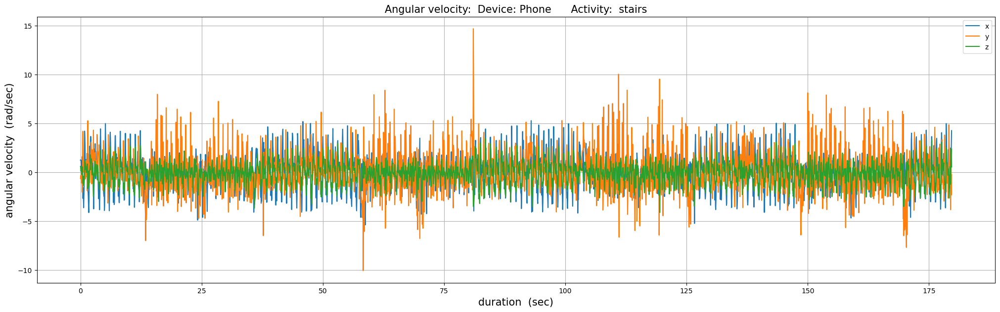

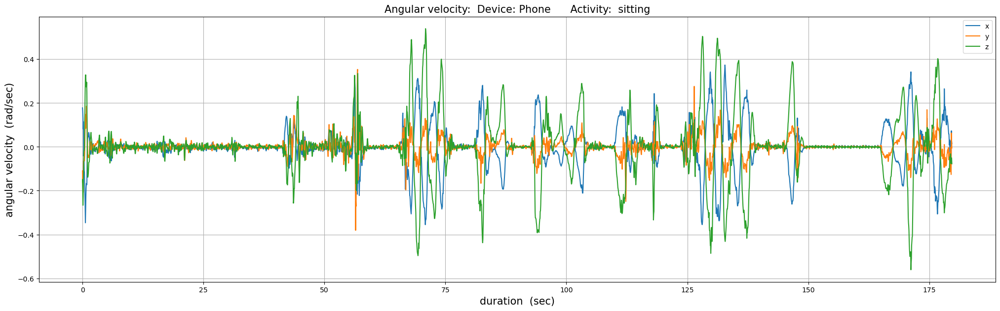

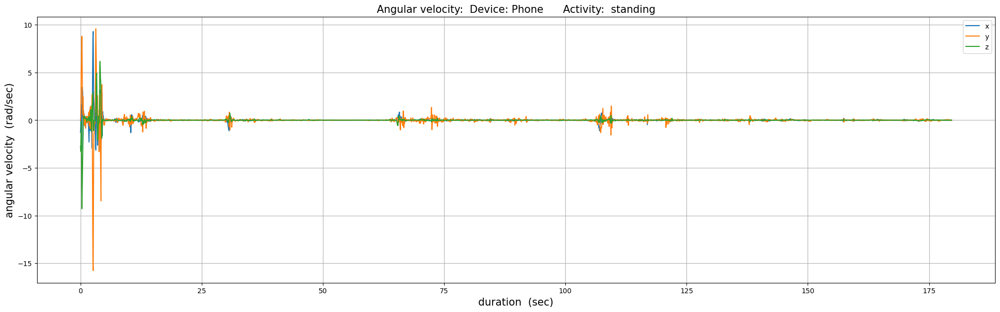

...

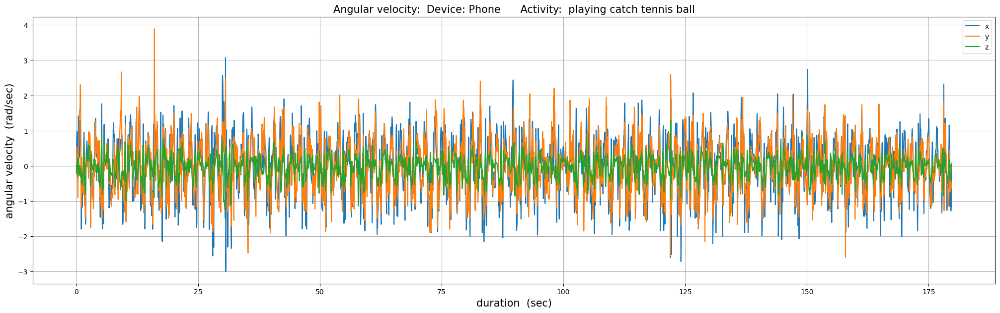

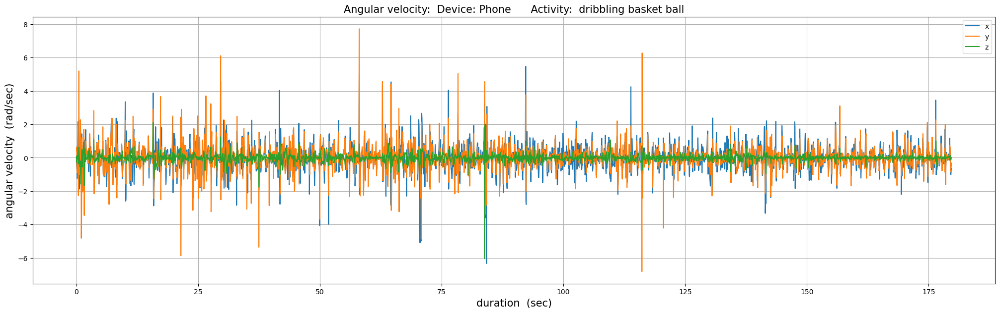

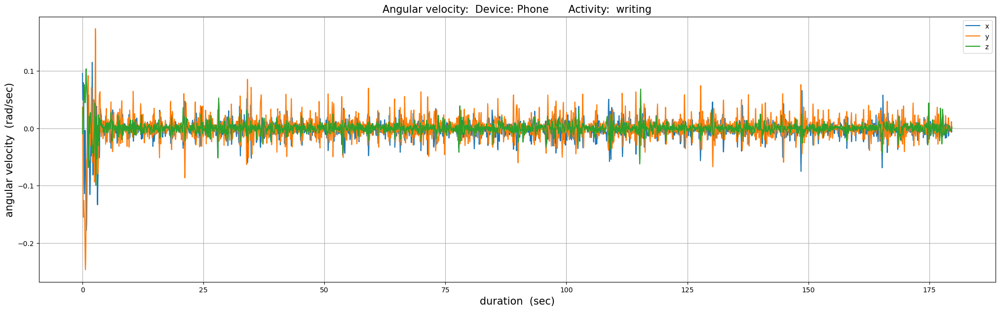

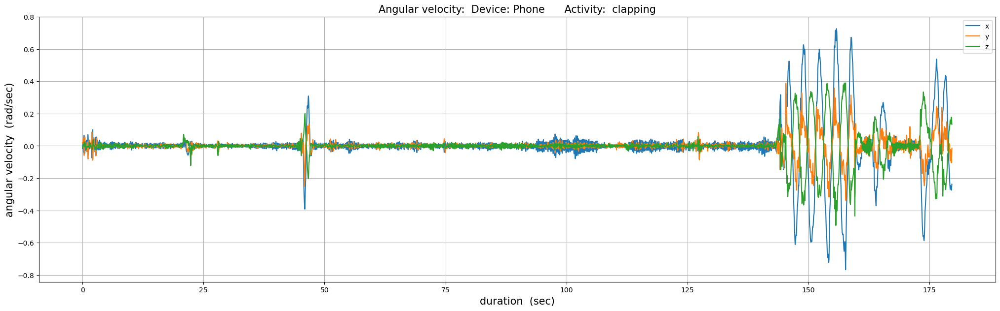

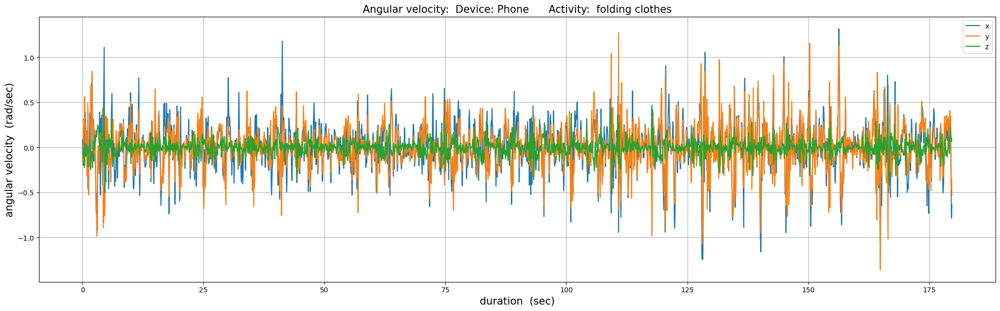

In [13]:
for key in activity_codes_mapping:
  show_ang_velocity_per_activity('Phone', raw_par_35_phone_ang_vel, activity_codes_mapping[key])

# Constructing the labeled datasets 

In [14]:
features = ['ACTIVITY',
            'X0', # 1st bin fraction of x-axis acceleration distribution
            'X1', # 2nd bin fraction ...
            'X2',
            'X3',
            'X4',
            'X5',
            'X6',
            'X7',
            'X8',
            'X9',
            'Y0', # 1st bin fraction of y-axis acceleration distribution
            'Y1', # 2nd bin fraction ...
            'Y2',
            'Y3',
            'Y4',
            'Y5',
            'Y6',
            'Y7',
            'Y8',
            'Y9',
            'Z0', # 1st bin fraction of z-axis acceleration distribution
            'Z1', # 2nd bin fraction ...
            'Z2',
            'Z3',
            'Z4',
            'Z5',
            'Z6',
            'Z7',
            'Z8',
            'Z9',
            'XAVG', # average sensor value over the window (per axis)
            'YAVG',
            'ZAVG',
            'XPEAK', # Time in milliseconds between the peaks in the wave associated with most activities. heuristically determined (per axis)
            'YPEAK',
            'ZPEAK',
            'XABSOLDEV', # Average absolute difference between the each of the 200 readings and the mean of those values (per axis)
            'YABSOLDEV',
            'ZABSOLDEV',
            'XSTANDDEV', # Standard deviation of the 200 window's values (per axis)  ***BUG!***
            'YSTANDDEV',
            'ZSTANDDEV',
            'XVAR', # Variance of the 200 window's values (per axis)   ***BUG!***
            'YVAR',
            'ZVAR',
            'XMFCC0', # short-term power spectrum of a wave, based on a linear cosine transform of a log power spectrum on a non-linear mel scale of frequency (13 values per axis)
            'XMFCC1',
            'XMFCC2',
            'XMFCC3',
            'XMFCC4',
            'XMFCC5',
            'XMFCC6',
            'XMFCC7',
            'XMFCC8',
            'XMFCC9',
            'XMFCC10',
            'XMFCC11',
            'XMFCC12',
            'YMFCC0', # short-term power spectrum of a wave, based on a linear cosine transform of a log power spectrum on a non-linear mel scale of frequency (13 values per axis)
            'YMFCC1',
            'YMFCC2',
            'YMFCC3',
            'YMFCC4',
            'YMFCC5',
            'YMFCC6',
            'YMFCC7',
            'YMFCC8',
            'YMFCC9',
            'YMFCC10',
            'YMFCC11',
            'YMFCC12',
            'ZMFCC0', # short-term power spectrum of a wave, based on a linear cosine transform of a log power spectrum on a non-linear mel scale of frequency (13 values per axis)
            'ZMFCC1',
            'ZMFCC2',
            'ZMFCC3',
            'ZMFCC4',
            'ZMFCC5',
            'ZMFCC6',
            'ZMFCC7',
            'ZMFCC8',
            'ZMFCC9',
            'ZMFCC10',
            'ZMFCC11',
            'ZMFCC12',
            'XYCOS', # The cosine distances between sensor values for pairs of axes (three pairs of axes)
            'XZCOS',
            'YZCOS',
            'XYCOR', # The correlation between sensor values for pairs of axes (three pairs of axes)
            'XZCOR',
            'YZCOR',
            'RESULTANT', # Average resultant value, computed by squaring each matching x, y, and z value, summing them, taking the square root, and then averaging these values over the 200 readings
            'PARTICIPANT'] # Categirical: 1600 -1650

len(features)

93

In [15]:
import glob

# List of duplicate files to be ignored; all identical to participant 1600
duplicate_files = [str(i) for i in range(1611, 1618)]  

# Path to directory containing ARFF files
path = 'C:/Users/25858831/Downloads/wisdm-dataset/wisdm-dataset/arff_files/phone/accel'

# Get a list of all ARFF files in the directory
all_files = glob.glob(path + "/*.arff")

# List to store DataFrames for each ARFF file
list_dfs_phone_accel = []

# Iterate over each ARFF file
for filename in all_files:
    # Ignore the duplicate files
    if any(dup_fn in filename for dup_fn in duplicate_files):
        continue
    # Read the ARFF file into a DataFrame, skipping the header rows
    df = pd.read_csv(filename, names=features, skiprows=96, index_col=None, header=0)
    list_dfs_phone_accel.append(df)

# Concatenate all DataFrames into a single DataFrame
all_phone_accel = pd.concat(list_dfs_phone_accel, axis=0, ignore_index=True, sort=False)

# Display the resulting DataFrame
all_phone_accel


,ACTIVITY,X0,X1,X2,X3,X4,X5,X6,X7,X8,...,ZMFCC11,ZMFCC12,XYCOS,XZCOS,YZCOS,XYCOR,XZCOR,YZCOR,RESULTANT,PARTICIPANT
0,A,0.235,0.470,0.275,0.020,0.000,0.0,0.0,0.0,0.0,...,0.486106,0.479859,-0.550668,0.049864,0.121354,-0.251024,0.164468,-0.110722,10.05180,1600
1,A,0.275,0.440,0.270,0.015,0.000,0.0,0.0,0.0,0.0,...,0.479571,0.473409,-0.633171,0.072129,0.161492,-0.386416,0.215680,-0.034375,10.11710,1600
2,A,0.320,0.430,0.245,0.000,0.005,0.0,0.0,0.0,0.0,...,0.483005,0.476798,-0.659493,0.087043,0.162157,-0.325151,0.272380,-0.077274,9.98384,1600
3,A,0.315,0.495,0.185,0.005,0.000,0.0,0.0,0.0,0.0,...,0.480711,0.474534,-0.712081,0.003810,0.210015,-0.364285,0.203131,0.015328,10.10600,1600
4,A,0.215,0.455,0.325,0.005,0.000,0.0,0.0,0.0,0.0,...,0.468836,0.462811,-0.534933,0.047553,0.275833,-0.216423,0.238500,-0.009870,10.05210,1600
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20645,S,1.000,0.000,0.000,0.000,0.000,0.0,0.0,0.0,0.0,...,0.208123,0.205448,0.965885,-0.006364,-0.192099,-0.708716,0.720199,-0.651551,9.40653,1650
20646,S,1.000,0.000,0.000,0.000,0.000,0.0,0.0,0.0,0.0,...,0.247499,0.244319,0.965439,0.861812,0.919008,-0.792718,-0.641690,0.547467,9.41056,1650
20647,S,1.000,0.000,0.000,0.000,0.000,0.0,0.0,0.0,0.0,...,0.320125,0.316012,0.942726,0.542231,0.357909,-0.542299,0.309224,-0.571912,9.44613,1650
20648,S,1.000,0.000,0.000,0.000,0.000,0.0,0.0,0.0,0.0,...,0.276562,0.273008,0.932298,-0.270526,-0.518026,-0.797365,0.813487,-0.677182,9.44593,1650


In [16]:
all_phone_accel.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20650 entries, 0 to 20649
Data columns (total 93 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   ACTIVITY     20650 non-null  object 
 1   X0           20650 non-null  float64
 2   X1           20650 non-null  float64
 3   X2           20650 non-null  float64
 4   X3           20650 non-null  float64
 5   X4           20650 non-null  float64
 6   X5           20650 non-null  float64
 7   X6           20650 non-null  float64
 8   X7           20650 non-null  float64
 9   X8           20650 non-null  float64
 10  X9           20650 non-null  float64
 11  Y0           20650 non-null  float64
 12  Y1           20650 non-null  float64
 13  Y2           20650 non-null  float64
 14  Y3           20650 non-null  float64
 15  Y4           20650 non-null  float64
 16  Y5           20650 non-null  float64
 17  Y6           20650 non-null  float64
 18  Y7           20650 non-null  float64
 19  Y8  

In [17]:
# Create a deep copy of the DataFrame all_phone_accel and assign it to all_phone_accel_breakpoint.
all_phone_accel_breakpoint = all_phone_accel.copy()

In [18]:
# Map activity codes in the 'ACTIVITY' column to human-readable activity names using the activity_codes_mapping dictionary,
# then calculate the count of each unique activity name.
all_phone_accel['ACTIVITY'].map(activity_codes_mapping).value_counts()

ACTIVITY
drinking from cup            1202
kicking soccer ball          1196
jogging                      1194
standing                     1175
brushing teeth               1174
walking                      1169
clapping                     1162
playing catch tennis ball    1161
sitting                      1155
folding clothes              1153
dribbling basket ball        1149
eating soup                  1144
eating sandwich              1134
writing                      1133
eating chips                 1128
eating pasta                 1077
typing                       1072
stairs                       1072
Name: count, dtype: int64

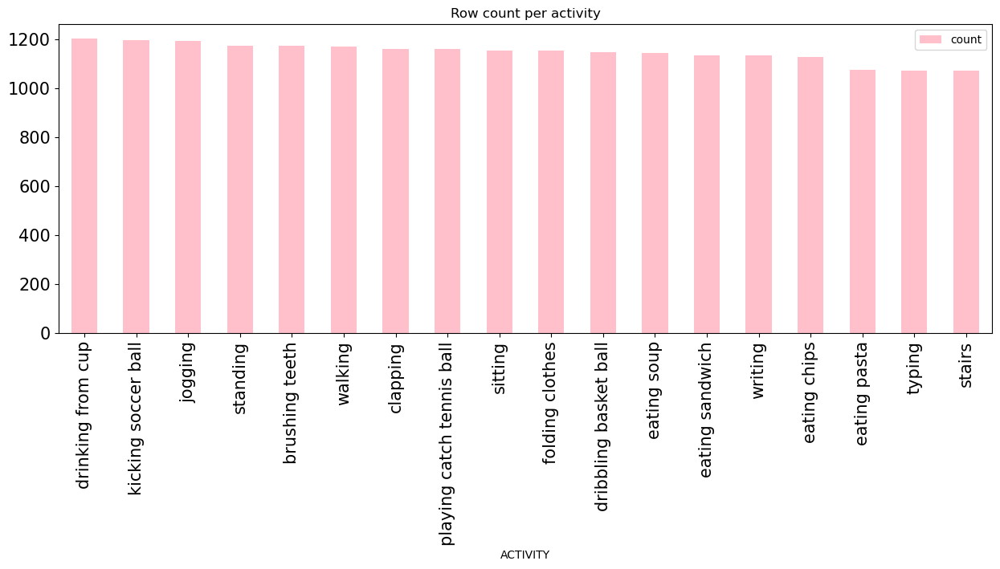

In [19]:
# Plot a bar chart showing the count of rows per activity after mapping activity codes to human-readable names
_ = all_phone_accel['ACTIVITY'].map(activity_codes_mapping).value_counts().plot(kind='bar',
                                                                               figsize=(15, 5),
                                                                               color='pink',
                                                                               title='Row count per activity',
                                                                               legend=True,
                                                                               fontsize=15)

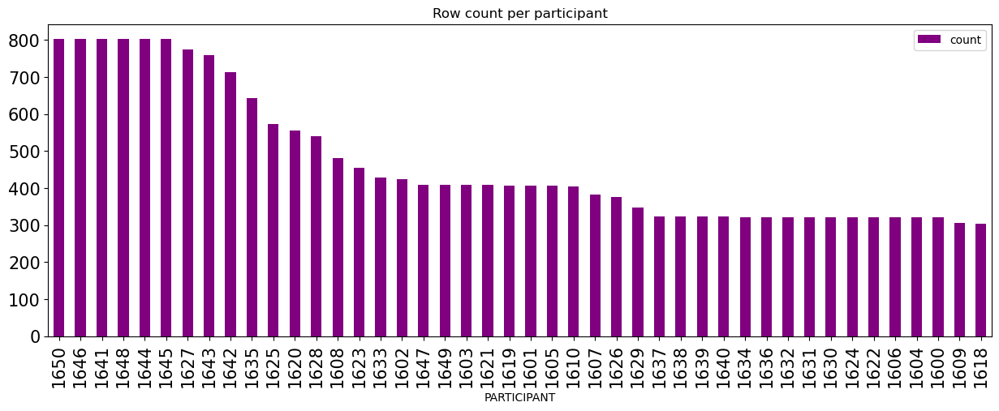

In [20]:
# Plot a bar chart showing the count of rows per participant
_ = all_phone_accel['PARTICIPANT'].value_counts().plot(kind='bar',
                                                      figsize=(15, 5),
                                                      color='purple',
                                                      title='Row count per participant',
                                                      legend=True,
                                                      fontsize=15)

In [21]:
# Retrieve the first few rows of specific columns related to acceleration features
# Columns: 'XABSOLDEV', 'YABSOLDEV', 'ZABSOLDEV', 'XSTANDDEV', 'YSTANDDEV', 'ZSTANDDEV', 'XVAR', 'YVAR', 'ZVAR'
all_phone_accel[['XABSOLDEV', 'YABSOLDEV', 'ZABSOLDEV', 'XSTANDDEV', 'YSTANDDEV', 'ZSTANDDEV', 'XVAR', 'YVAR', 'ZVAR']].head()

,XABSOLDEV,YABSOLDEV,ZABSOLDEV,XSTANDDEV,YSTANDDEV,ZSTANDDEV,XVAR,YVAR,ZVAR
0,1.59095,3.29508,1.60941,0.141170,0.283329,0.159800,0.375726,0.532286,0.399750
1,1.77817,3.33490,1.68296,0.161229,0.287955,0.157993,0.401533,0.536614,0.397483
2,1.70505,3.14244,1.69288,0.156200,0.269307,0.159797,0.395221,0.518948,0.399746
3,1.62315,3.32790,1.57944,0.141721,0.283364,0.154396,0.376459,0.532320,0.392933
4,1.48888,3.01196,1.45931,0.131537,0.256423,0.140283,0.362681,0.506383,0.374544


In [22]:
# Drop columns related to standard deviation and variance of acceleration ('XSTANDDEV', 'YSTANDDEV', 'ZSTANDDEV', 'XVAR', 'YVAR', 'ZVAR')
# These columns are being removed from the DataFrame all_phone_accel to focus on other relevant features.
all_phone_accel.drop(['XSTANDDEV', 'YSTANDDEV', 'ZSTANDDEV', 'XVAR', 'YVAR', 'ZVAR'], axis=1, inplace=True)

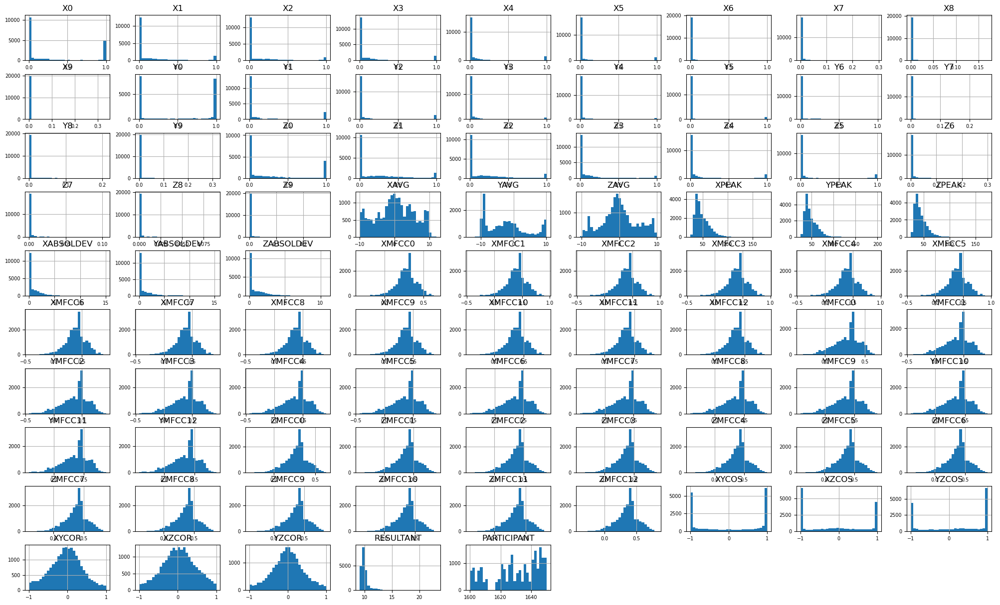

In [23]:
# Create histograms for all numerical columns in the DataFrame all_phone_accel
ax = all_phone_accel.hist(bins=30, figsize=(25, 15), xlabelsize=7, ylabelsize=7)

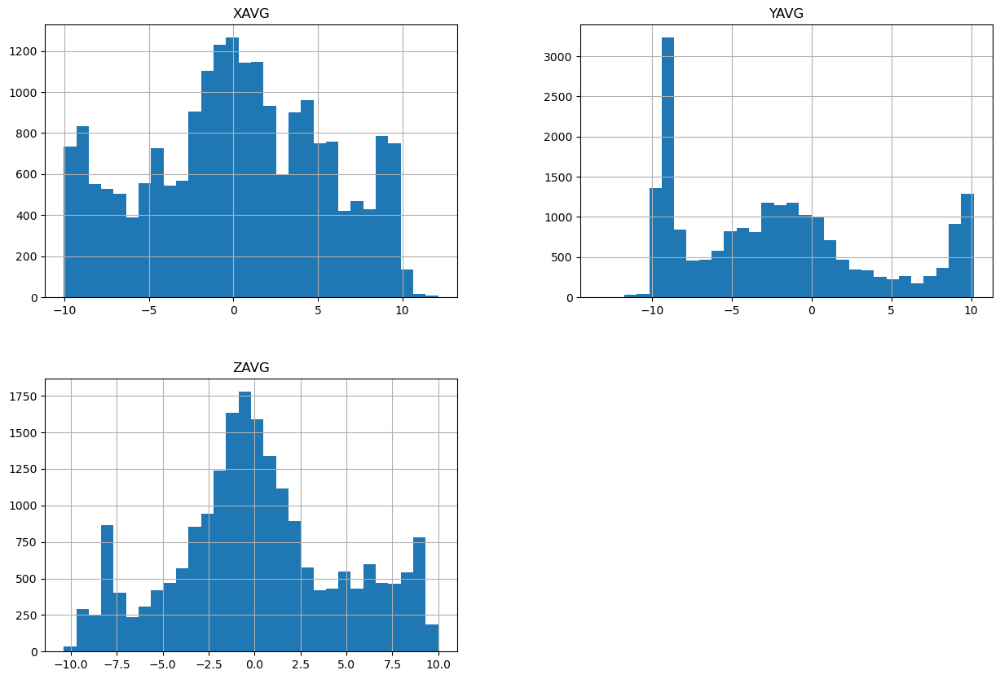

In [24]:
# Generate histograms for the average values of accelerometer readings along the x, y, and z axes
# Columns: 'XAVG', 'YAVG', 'ZAVG'
_ = all_phone_accel[['XAVG', 'YAVG', 'ZAVG']].hist(bins=30, figsize=(15, 10))

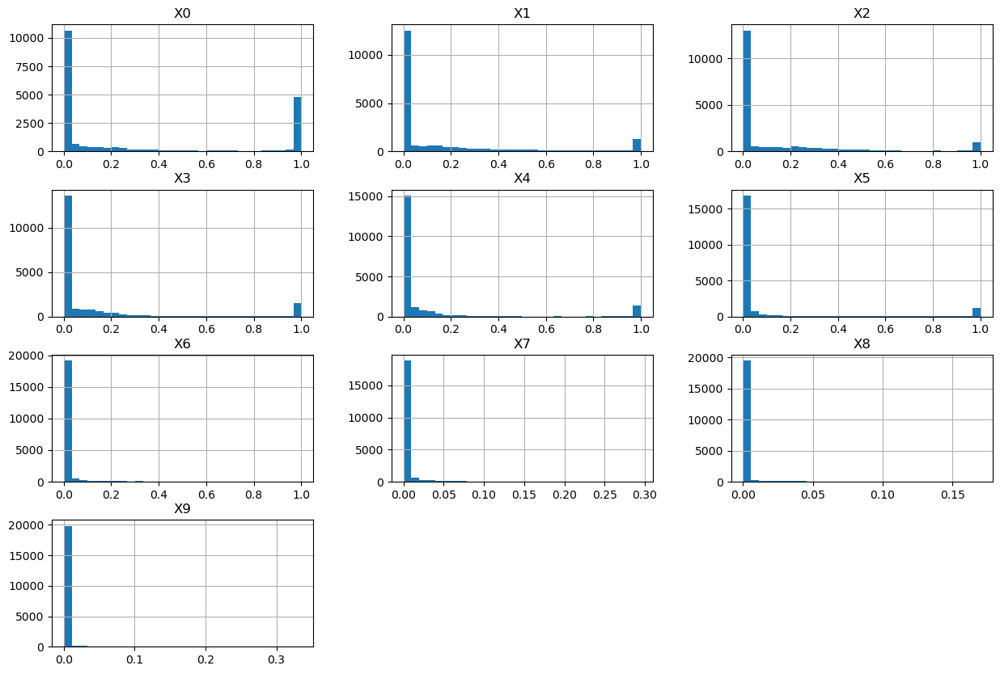

In [25]:
# histograms for specific columns ('X0' to 'X9') in the DataFrame all_phone_accel
_ = all_phone_accel[['X0', 'X1', 'X2', 'X3', 'X4', 'X5', 'X6', 'X7', 'X8', 'X9']].hist(bins=30, figsize=(15, 10))

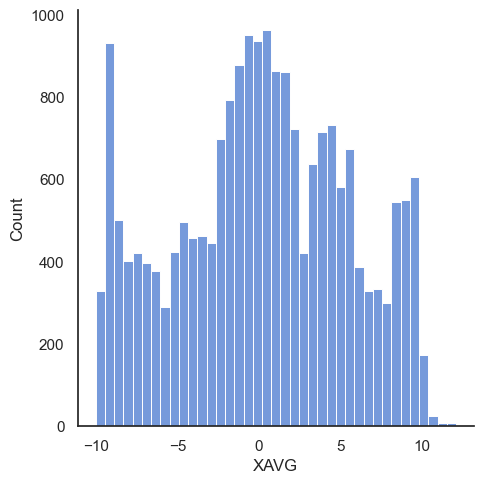

In [26]:
# Set seaborn color codes and style settings
sns.set(color_codes=True)
sns.set(style="white", palette="muted")

# Create a distribution plot (displot) for the 'XAVG' column in the DataFrame all_phone_accel
# The distribution plot visualizes the spread and shape of the 'XAVG' variable
_ = sns.displot(all_phone_accel['XAVG'])

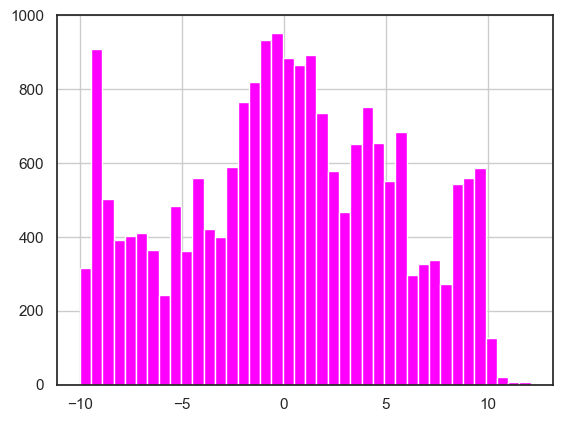

In [27]:
# Create a histogram for the 'XAVG' column in the DataFrame all_phone_accel
# The histogram represents the distribution of average values along the x-axis
_ = all_phone_accel['XAVG'].hist(bins=40, color='magenta')

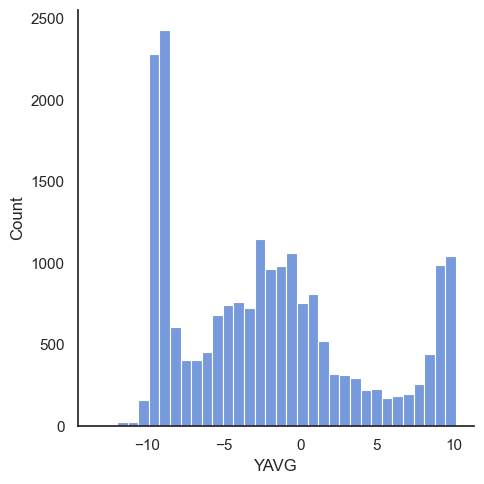

In [28]:
# Create a distribution plot (displot) for the 'YAVG' column in the DataFrame all_phone_accel
# The distribution plot visualizes the spread and shape of the 'YAVG' variable
_ = sns.displot(all_phone_accel['YAVG'])

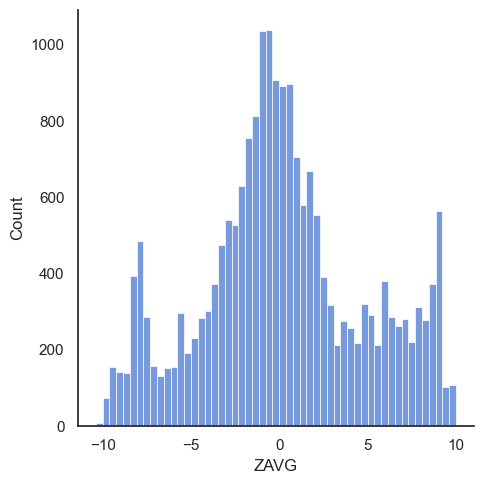

In [29]:
# Create a distribution plot (displot) for the 'ZAVG' column in the DataFrame all_phone_accel
# This plot visualizes the spread and shape of the 'ZAVG' variable
_ = sns.displot(all_phone_accel['ZAVG'])

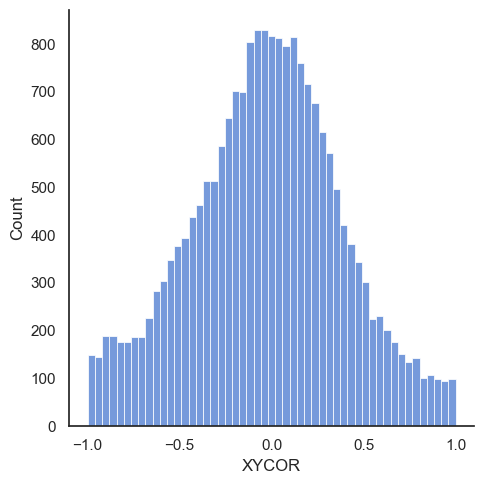

In [30]:
# Create a distribution plot (displot) for the 'XYCOR' column in the DataFrame all_phone_accel
# This plot visualizes the spread and shape of the 'XYCOR' variable
_ = sns.displot(all_phone_accel['XYCOR'])

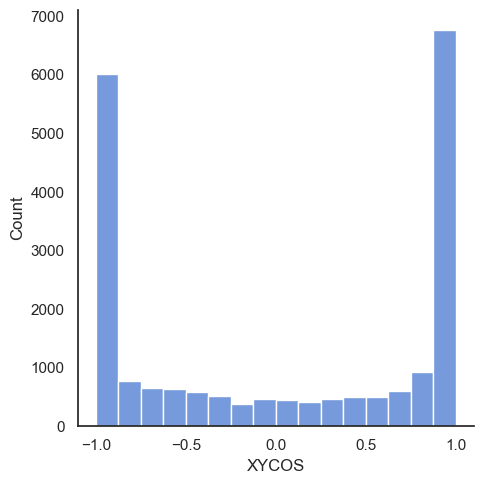

In [31]:
# Create a distribution plot (displot) for the 'XYCOS' column in the DataFrame all_phone_accel
# This plot visualizes the spread and shape of the 'XYCOS' variable
_ = sns.displot(all_phone_accel['XYCOS'])

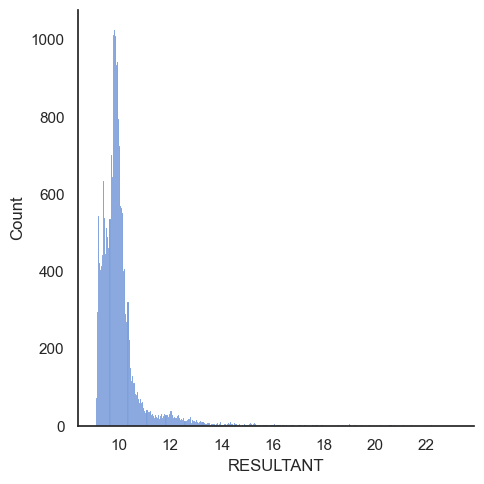

In [32]:
# Create a distribution plot (displot) for the 'RESULTANT' column in the DataFrame all_phone_accel
# This plot visualizes the spread and shape of the 'RESULTANT' variable
_ = sns.displot(all_phone_accel['RESULTANT'])

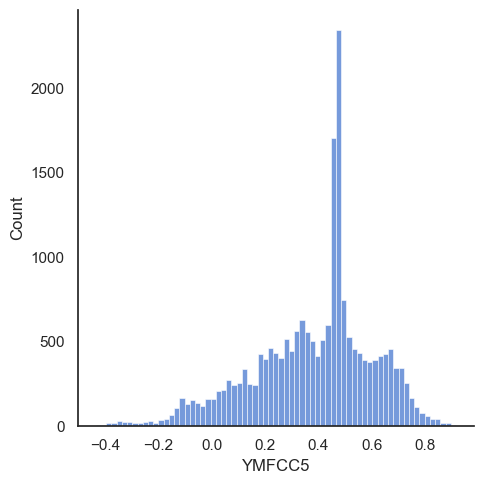

In [33]:
# Create a distribution plot (displot) for the 'YMFCC5' column in the DataFrame all_phone_accel
# This plot visualizes the spread and shape of the 'YMFCC5' variable
_ = sns.displot(all_phone_accel['YMFCC5'])

# Input data pre-processing

In [34]:
# Remove the 'PARTICIPANT' column from the DataFrame all_phone_accel
all_phone_accel.drop('PARTICIPANT', axis=1, inplace=True)

In [35]:
# Separate the target variable 'ACTIVITY' from the features in the DataFrame all_phone_accel
y = all_phone_accel.ACTIVITY
X = all_phone_accel.drop('ACTIVITY', axis=1)

# Split the data into training and testing sets
# 75% of the data is used for training and 25% for testing
# Data is shuffled before splitting, and the class distribution of the target variable is preserved (stratified splitting)
X_train, X_test, y_train, y_test = train_test_split(X, y, 
                                                    train_size=0.75, 
                                                    test_size=0.25,
                                                    shuffle=True, 
                                                    stratify=all_phone_accel.ACTIVITY)

In [36]:
X_train

,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,ZMFCC10,ZMFCC11,ZMFCC12,XYCOS,XZCOS,YZCOS,XYCOR,XZCOR,YZCOR,RESULTANT
8910,0.950,0.000,0.00,0.050,0.00,0.000,0.0,0.0,0.0,0.0,...,0.489762,0.484060,0.477840,0.856114,0.999878,0.855155,-0.994033,0.999113,-0.994322,10.27750
9216,0.395,0.605,0.00,0.000,0.00,0.000,0.0,0.0,0.0,0.0,...,0.130543,0.129024,0.127366,0.959292,0.920772,0.842955,-0.564157,0.722224,-0.498397,9.81836
5303,0.820,0.165,0.01,0.005,0.00,0.000,0.0,0.0,0.0,0.0,...,0.536566,0.530320,0.523505,-0.906674,-0.500467,0.670718,-0.084737,0.344609,0.186485,9.99373
1892,0.130,0.470,0.32,0.055,0.02,0.005,0.0,0.0,0.0,0.0,...,0.588944,0.582087,0.574608,-0.111089,0.360987,0.171909,0.158743,0.406529,0.023071,10.42490
16057,0.675,0.325,0.00,0.000,0.00,0.000,0.0,0.0,0.0,0.0,...,0.284600,0.281287,0.277672,0.999781,0.999650,0.999846,-0.139861,-0.205220,-0.223256,9.27945
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19644,0.000,0.000,0.00,0.000,1.00,0.000,0.0,0.0,0.0,0.0,...,0.381934,0.377488,0.372637,-0.999859,-0.999826,0.999951,0.520116,0.866972,0.373099,10.15050
9862,0.000,0.000,0.00,0.015,0.95,0.035,0.0,0.0,0.0,0.0,...,0.422678,0.417757,0.412389,0.874305,-0.993522,-0.863473,0.164756,0.422014,0.258377,10.06400
12119,0.000,1.000,0.00,0.000,0.00,0.000,0.0,0.0,0.0,0.0,...,0.234775,0.232042,0.229060,0.998044,-0.996131,-0.998735,0.031914,0.338372,0.778790,9.53041
4868,1.000,0.000,0.00,0.000,0.00,0.000,0.0,0.0,0.0,0.0,...,0.413234,0.408423,0.403175,0.999752,-0.999939,-0.999662,0.467716,0.593509,0.190948,9.69235


In [37]:
y_train

8910     H
9216     S
5303     O
1892     A
16057    F
        ..
19644    J
9862     R
12119    K
4868     R
19794    Q
Name: ACTIVITY, Length: 15487, dtype: object

In [38]:
X_test

,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,ZMFCC10,ZMFCC11,ZMFCC12,XYCOS,XZCOS,YZCOS,XYCOR,XZCOR,YZCOR,RESULTANT
6783,0.000,0.000,0.000,0.00,1.000,0.000,0.000,0.000,0.000,0.000,...,0.337074,0.333149,0.328869,-0.998735,-0.999275,0.997760,0.648341,-0.080840,-0.747236,9.86013
7415,1.000,0.000,0.000,0.00,0.000,0.000,0.000,0.000,0.000,0.000,...,0.324075,0.320302,0.316187,0.999643,-0.999542,-0.999780,-0.382757,0.291798,0.253291,9.50512
573,0.995,0.005,0.000,0.00,0.000,0.000,0.000,0.000,0.000,0.000,...,0.435616,0.430545,0.425012,-0.997233,-0.999102,0.998709,0.352269,0.007449,-0.339792,9.57426
10988,0.510,0.185,0.090,0.11,0.065,0.010,0.020,0.000,0.005,0.005,...,0.656690,0.649045,0.640704,-0.406428,0.341983,-0.161812,-0.269523,0.293200,-0.002528,12.00260
12726,1.000,0.000,0.000,0.00,0.000,0.000,0.000,0.000,0.000,0.000,...,0.371546,0.367221,0.362502,0.603875,-0.899670,-0.337267,-0.358252,0.183842,0.756845,9.82411
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13821,0.000,0.000,0.000,0.00,0.000,1.000,0.000,0.000,0.000,0.000,...,0.308193,0.304605,0.300691,-0.999723,-0.999801,0.999480,-0.413653,0.582715,-0.190678,9.94483
11305,0.040,0.060,0.270,0.23,0.255,0.085,0.055,0.005,0.000,0.000,...,0.671493,0.663676,0.655147,-0.668457,-0.101721,-0.141762,-0.065115,-0.051778,-0.418985,11.98480
9585,0.065,0.165,0.165,0.10,0.085,0.110,0.050,0.065,0.075,0.120,...,0.687511,0.679507,0.670775,0.228281,0.362382,0.094925,0.160815,0.108197,0.025898,9.84472
10290,0.000,0.000,1.000,0.00,0.000,0.000,0.000,0.000,0.000,0.000,...,0.041299,0.040818,0.040294,-0.997885,-0.995785,0.995895,0.415058,-0.311253,-0.356244,9.71269


In [39]:
y_test

6783     I
7415     Q
573      L
10988    B
12726    I
        ..
13821    G
11305    A
9585     B
10290    E
20133    G
Name: ACTIVITY, Length: 5163, dtype: object

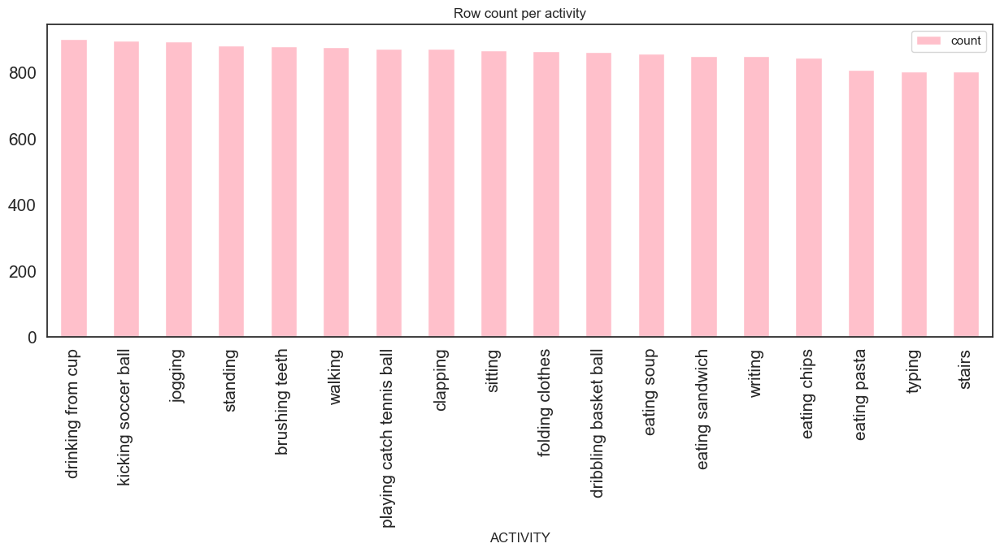

In [40]:
# Map activity codes to human-readable activity names using the activity_codes_mapping dictionary,
# then calculate the count of each unique activity name in the training data (y_train).
# This provides insight into the distribution of activities in the training dataset.
_ = y_train.map(activity_codes_mapping).value_counts().plot(kind='bar',
                                                            figsize=(15, 5),
                                                            color='pink',
                                                            title='Row count per activity',
                                                            legend=True,
                                                            fontsize=15)

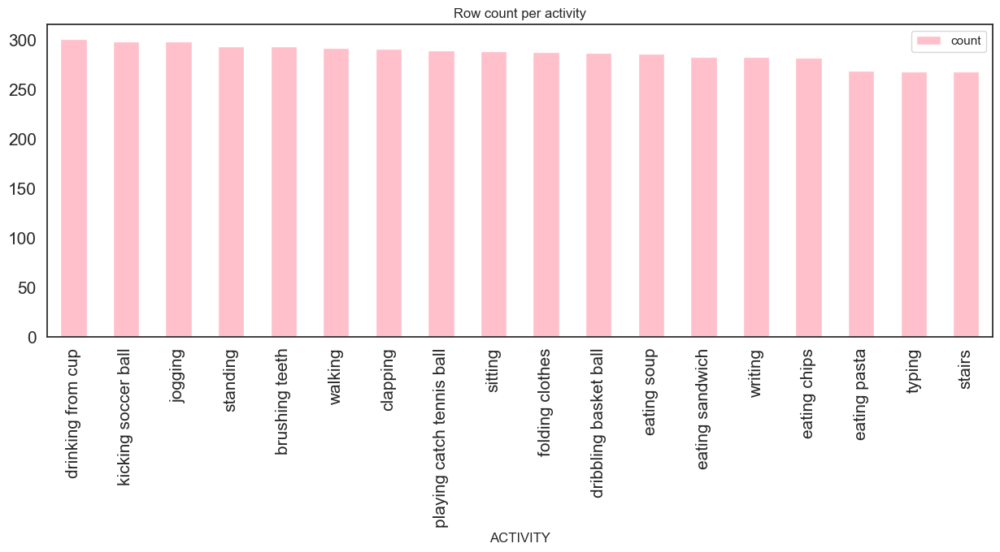

In [41]:
# Map activity codes to human-readable activity names using the activity_codes_mapping dictionary,
# then calculate the count of each unique activity name in the testing data (y_test).
# This provides insight into the distribution of activities in the testing dataset.
_ = y_test.map(activity_codes_mapping).value_counts().plot(kind='bar',
                                                           figsize=(15, 5),
                                                           color='pink',
                                                           title='Row count per activity',
                                                           legend=True,
                                                           fontsize=15)

In [42]:
# insert the Y column into train dataset
X_train.insert(0, 'Y', y_train)

In [43]:
X_train

,Y,X0,X1,X2,X3,X4,X5,X6,X7,X8,...,ZMFCC10,ZMFCC11,ZMFCC12,XYCOS,XZCOS,YZCOS,XYCOR,XZCOR,YZCOR,RESULTANT
8910,H,0.950,0.000,0.00,0.050,0.00,0.000,0.0,0.0,0.0,...,0.489762,0.484060,0.477840,0.856114,0.999878,0.855155,-0.994033,0.999113,-0.994322,10.27750
9216,S,0.395,0.605,0.00,0.000,0.00,0.000,0.0,0.0,0.0,...,0.130543,0.129024,0.127366,0.959292,0.920772,0.842955,-0.564157,0.722224,-0.498397,9.81836
5303,O,0.820,0.165,0.01,0.005,0.00,0.000,0.0,0.0,0.0,...,0.536566,0.530320,0.523505,-0.906674,-0.500467,0.670718,-0.084737,0.344609,0.186485,9.99373
1892,A,0.130,0.470,0.32,0.055,0.02,0.005,0.0,0.0,0.0,...,0.588944,0.582087,0.574608,-0.111089,0.360987,0.171909,0.158743,0.406529,0.023071,10.42490
16057,F,0.675,0.325,0.00,0.000,0.00,0.000,0.0,0.0,0.0,...,0.284600,0.281287,0.277672,0.999781,0.999650,0.999846,-0.139861,-0.205220,-0.223256,9.27945
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19644,J,0.000,0.000,0.00,0.000,1.00,0.000,0.0,0.0,0.0,...,0.381934,0.377488,0.372637,-0.999859,-0.999826,0.999951,0.520116,0.866972,0.373099,10.15050
9862,R,0.000,0.000,0.00,0.015,0.95,0.035,0.0,0.0,0.0,...,0.422678,0.417757,0.412389,0.874305,-0.993522,-0.863473,0.164756,0.422014,0.258377,10.06400
12119,K,0.000,1.000,0.00,0.000,0.00,0.000,0.0,0.0,0.0,...,0.234775,0.232042,0.229060,0.998044,-0.996131,-0.998735,0.031914,0.338372,0.778790,9.53041
4868,R,1.000,0.000,0.00,0.000,0.00,0.000,0.0,0.0,0.0,...,0.413234,0.408423,0.403175,0.999752,-0.999939,-0.999662,0.467716,0.593509,0.190948,9.69235


# XPEAK

In [44]:
# Calculate the upper threshold for the feature 'XPEAK' based on its mean and standard deviation in the training data (X_train)
# The threshold is set as the mean plus nine times the standard deviation 
# commonly used value for identifying outliers or extreme values in the data.
upper_threshold_XPEAK = X_train.XPEAK.mean() + 9 * X_train.XPEAK.std()
upper_threshold_XPEAK

175.93513853074194

In [45]:
X_train.XPEAK.max()

179.0

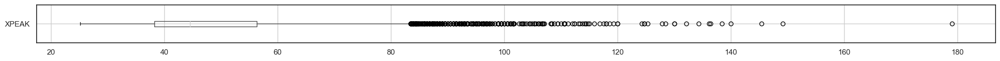

In [46]:
_ = X_train.boxplot(column=['XPEAK'], figsize=[25,1], vert=False)

In [47]:
X_train = X_train[X_train.XPEAK < upper_threshold_XPEAK].copy()

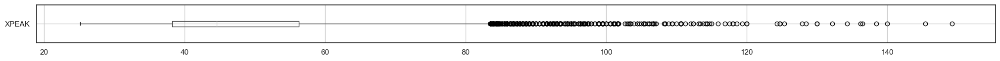

In [48]:
#X_train
_ = X_train.boxplot(column=['XPEAK'], figsize=[25,1], vert=False)

# YPEAK

In [49]:
# Calculate the upper threshold for the feature 'YPEAK' based on its mean and standard deviation in the training data (X_train)
# The threshold is set as the mean plus nine times the standard deviation 
# commonly used value for identifying outliers or extreme values in the data.
upper_threshold_YPEAK = X_train.YPEAK.mean() + 9*X_train.YPEAK.std()
upper_threshold_YPEAK

184.5825084905832

In [50]:
X_train.YPEAK.max()

200.0

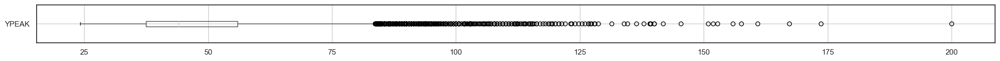

In [51]:
#X_train
_ = X_train.boxplot(column=['YPEAK'], figsize=[25,1], vert=False)

In [52]:
X_train = X_train[X_train.YPEAK < upper_threshold_YPEAK].copy()

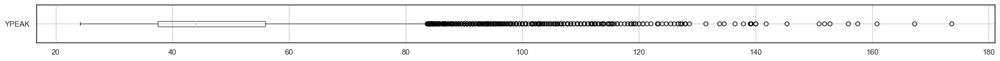

In [53]:
#X_train
_ = X_train.boxplot(column=['YPEAK'], figsize=[25,1], vert=False)

# ZPEAK

In [54]:
# Calculate the upper threshold for the feature 'ZPEAK' based on its mean and standard deviation in the training data (X_train)
# The threshold is set as the mean plus nine times the standard deviation 
# commonly used value for identifying outliers or extreme values in the data.
upper_threshold_ZPEAK = X_train.ZPEAK.mean() + 9*X_train.ZPEAK.std()
upper_threshold_ZPEAK

149.46016802670766

In [55]:
X_train.ZPEAK.max()

173.0

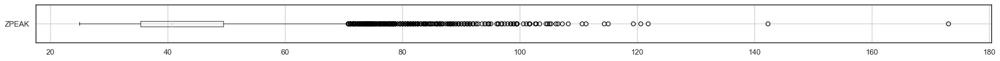

In [56]:
#X_train
_ = X_train.boxplot(column=['ZPEAK'], figsize=[25,1], vert=False)

In [57]:
X_train = X_train[X_train.ZPEAK < upper_threshold_ZPEAK].copy()

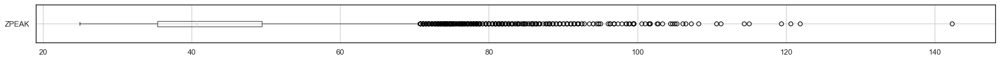

In [58]:
#X_train
_ = X_train.boxplot(column=['ZPEAK'], figsize=[25,1], vert=False)

# Separate Y-Train

In [59]:
y_train = X_train['Y']

In [60]:
y_train

8910     H
9216     S
5303     O
1892     A
16057    F
        ..
19644    J
9862     R
12119    K
4868     R
19794    Q
Name: Y, Length: 15484, dtype: object

In [61]:
X_train.drop(['Y'], axis = 1, inplace = True)

# Scaling

In [62]:
# Create a MaxAbsScaler object and fit it to the specified features in the training data (X_train)
# Features: 'XAVG', 'YAVG', 'ZAVG', 'XPEAK', 'YPEAK', 'ZPEAK', 'XABSOLDEV', 'YABSOLDEV', 'ZABSOLDEV', 'RESULTANT'
# MaxAbsScaler scales each feature by dividing it by the maximum absolute value of that feature, preserving the sign of the input data.
scaling_transformer = MaxAbsScaler().fit(X_train[['XAVG', 'YAVG', 'ZAVG', 'XPEAK', 'YPEAK', 'ZPEAK', 'XABSOLDEV', 'YABSOLDEV', 'ZABSOLDEV', 'RESULTANT']])

In [63]:
# Apply the transformation learned by the scaling_transformer to the specified features in the training data (X_train)
X_train[['XAVG', 'YAVG', 'ZAVG', 'XPEAK', 'YPEAK', 'ZPEAK', 'XABSOLDEV', 'YABSOLDEV', 'ZABSOLDEV', 'RESULTANT']] = scaling_transformer.transform(X_train[['XAVG', 'YAVG', 'ZAVG', 'XPEAK', 'YPEAK', 'ZPEAK', 'XABSOLDEV', 'YABSOLDEV', 'ZABSOLDEV', 'RESULTANT']])


In [64]:
X_test = X_test.copy()

In [65]:
# Apply the transformation learned by the scaling_transformer to the specified features in the training data (X_test)
X_test[['XAVG', 'YAVG', 'ZAVG', 'XPEAK', 'YPEAK', 'ZPEAK', 'XABSOLDEV', 'YABSOLDEV', 'ZABSOLDEV', 'RESULTANT']] = scaling_transformer.transform(X_test[['XAVG', 'YAVG', 'ZAVG', 'XPEAK', 'YPEAK', 'ZPEAK', 'XABSOLDEV', 'YABSOLDEV', 'ZABSOLDEV', 'RESULTANT']])

In [66]:
X_test

,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,ZMFCC10,ZMFCC11,ZMFCC12,XYCOS,XZCOS,YZCOS,XYCOR,XZCOR,YZCOR,RESULTANT
6783,0.000,0.000,0.000,0.00,1.000,0.000,0.000,0.000,0.000,0.000,...,0.337074,0.333149,0.328869,-0.998735,-0.999275,0.997760,0.648341,-0.080840,-0.747236,0.425833
7415,1.000,0.000,0.000,0.00,0.000,0.000,0.000,0.000,0.000,0.000,...,0.324075,0.320302,0.316187,0.999643,-0.999542,-0.999780,-0.382757,0.291798,0.253291,0.410501
573,0.995,0.005,0.000,0.00,0.000,0.000,0.000,0.000,0.000,0.000,...,0.435616,0.430545,0.425012,-0.997233,-0.999102,0.998709,0.352269,0.007449,-0.339792,0.413487
10988,0.510,0.185,0.090,0.11,0.065,0.010,0.020,0.000,0.005,0.005,...,0.656690,0.649045,0.640704,-0.406428,0.341983,-0.161812,-0.269523,0.293200,-0.002528,0.518361
12726,1.000,0.000,0.000,0.00,0.000,0.000,0.000,0.000,0.000,0.000,...,0.371546,0.367221,0.362502,0.603875,-0.899670,-0.337267,-0.358252,0.183842,0.756845,0.424278
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13821,0.000,0.000,0.000,0.00,0.000,1.000,0.000,0.000,0.000,0.000,...,0.308193,0.304605,0.300691,-0.999723,-0.999801,0.999480,-0.413653,0.582715,-0.190678,0.429491
11305,0.040,0.060,0.270,0.23,0.255,0.085,0.055,0.005,0.000,0.000,...,0.671493,0.663676,0.655147,-0.668457,-0.101721,-0.141762,-0.065115,-0.051778,-0.418985,0.517592
9585,0.065,0.165,0.165,0.10,0.085,0.110,0.050,0.065,0.075,0.120,...,0.687511,0.679507,0.670775,0.228281,0.362382,0.094925,0.160815,0.108197,0.025898,0.425168
10290,0.000,0.000,1.000,0.00,0.000,0.000,0.000,0.000,0.000,0.000,...,0.041299,0.040818,0.040294,-0.997885,-0.995785,0.995895,0.415058,-0.311253,-0.356244,0.419466


In [67]:
X_train.reset_index(drop = True, inplace = True)
X_train

,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,ZMFCC10,ZMFCC11,ZMFCC12,XYCOS,XZCOS,YZCOS,XYCOR,XZCOR,YZCOR,RESULTANT
0,0.950,0.000,0.00,0.050,0.00,0.000,0.0,0.0,0.0,0.0,...,0.489762,0.484060,0.477840,0.856114,0.999878,0.855155,-0.994033,0.999113,-0.994322,0.443859
1,0.395,0.605,0.00,0.000,0.00,0.000,0.0,0.0,0.0,0.0,...,0.130543,0.129024,0.127366,0.959292,0.920772,0.842955,-0.564157,0.722224,-0.498397,0.424029
2,0.820,0.165,0.01,0.005,0.00,0.000,0.0,0.0,0.0,0.0,...,0.536566,0.530320,0.523505,-0.906674,-0.500467,0.670718,-0.084737,0.344609,0.186485,0.431603
3,0.130,0.470,0.32,0.055,0.02,0.005,0.0,0.0,0.0,0.0,...,0.588944,0.582087,0.574608,-0.111089,0.360987,0.171909,0.158743,0.406529,0.023071,0.450224
4,0.675,0.325,0.00,0.000,0.00,0.000,0.0,0.0,0.0,0.0,...,0.284600,0.281287,0.277672,0.999781,0.999650,0.999846,-0.139861,-0.205220,-0.223256,0.400755
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15479,0.000,0.000,0.00,0.000,1.00,0.000,0.0,0.0,0.0,0.0,...,0.381934,0.377488,0.372637,-0.999859,-0.999826,0.999951,0.520116,0.866972,0.373099,0.438374
15480,0.000,0.000,0.00,0.015,0.95,0.035,0.0,0.0,0.0,0.0,...,0.422678,0.417757,0.412389,0.874305,-0.993522,-0.863473,0.164756,0.422014,0.258377,0.434638
15481,0.000,1.000,0.00,0.000,0.00,0.000,0.0,0.0,0.0,0.0,...,0.234775,0.232042,0.229060,0.998044,-0.996131,-0.998735,0.031914,0.338372,0.778790,0.411594
15482,1.000,0.000,0.00,0.000,0.00,0.000,0.0,0.0,0.0,0.0,...,0.413234,0.408423,0.403175,0.999752,-0.999939,-0.999662,0.467716,0.593509,0.190948,0.418587


In [68]:
X_test.reset_index(drop = True, inplace = True)
X_test

,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,ZMFCC10,ZMFCC11,ZMFCC12,XYCOS,XZCOS,YZCOS,XYCOR,XZCOR,YZCOR,RESULTANT
0,0.000,0.000,0.000,0.00,1.000,0.000,0.000,0.000,0.000,0.000,...,0.337074,0.333149,0.328869,-0.998735,-0.999275,0.997760,0.648341,-0.080840,-0.747236,0.425833
1,1.000,0.000,0.000,0.00,0.000,0.000,0.000,0.000,0.000,0.000,...,0.324075,0.320302,0.316187,0.999643,-0.999542,-0.999780,-0.382757,0.291798,0.253291,0.410501
2,0.995,0.005,0.000,0.00,0.000,0.000,0.000,0.000,0.000,0.000,...,0.435616,0.430545,0.425012,-0.997233,-0.999102,0.998709,0.352269,0.007449,-0.339792,0.413487
3,0.510,0.185,0.090,0.11,0.065,0.010,0.020,0.000,0.005,0.005,...,0.656690,0.649045,0.640704,-0.406428,0.341983,-0.161812,-0.269523,0.293200,-0.002528,0.518361
4,1.000,0.000,0.000,0.00,0.000,0.000,0.000,0.000,0.000,0.000,...,0.371546,0.367221,0.362502,0.603875,-0.899670,-0.337267,-0.358252,0.183842,0.756845,0.424278
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5158,0.000,0.000,0.000,0.00,0.000,1.000,0.000,0.000,0.000,0.000,...,0.308193,0.304605,0.300691,-0.999723,-0.999801,0.999480,-0.413653,0.582715,-0.190678,0.429491
5159,0.040,0.060,0.270,0.23,0.255,0.085,0.055,0.005,0.000,0.000,...,0.671493,0.663676,0.655147,-0.668457,-0.101721,-0.141762,-0.065115,-0.051778,-0.418985,0.517592
5160,0.065,0.165,0.165,0.10,0.085,0.110,0.050,0.065,0.075,0.120,...,0.687511,0.679507,0.670775,0.228281,0.362382,0.094925,0.160815,0.108197,0.025898,0.425168
5161,0.000,0.000,1.000,0.00,0.000,0.000,0.000,0.000,0.000,0.000,...,0.041299,0.040818,0.040294,-0.997885,-0.995785,0.995895,0.415058,-0.311253,-0.356244,0.419466


In [69]:
y_train.reset_index(drop = True, inplace = True)
y_train

0        H
1        S
2        O
3        A
4        F
        ..
15479    J
15480    R
15481    K
15482    R
15483    Q
Name: Y, Length: 15484, dtype: object

In [70]:
y_test.reset_index(drop = True, inplace = True)
y_test

0       I
1       Q
2       L
3       B
4       I
       ..
5158    G
5159    A
5160    B
5161    E
5162    G
Name: ACTIVITY, Length: 5163, dtype: object

# Visualisation of triples 

In [71]:
# Read a CSV file located at the specified filepath (fn) into a DataFrame par_23_df
fn = 'C:/Users/25858831/Downloads/wisdm-dataset/wisdm-dataset/arff_files/phone/accel/data_1623_accel_phone.arff'

# Use the provided features list as column names and skip the first 96 rows
# Set the first row as the header of the DataFrame
par_23_df = pd.read_csv(fn, names=features, skiprows=96, index_col=None, header=0)

# Create a new column 'ACT' in par_23_df by mapping the 'ACTIVITY' column values to their corresponding human-readable activity names
par_23_df['ACT'] = par_23_df['ACTIVITY'].map(activity_codes_mapping)


In [72]:
# Create a 3D scatter plot using Plotly Express with data from the DataFrame par_23_df
# Visualize the 'XAVG', 'YAVG', and 'ZAVG' columns as the x, y, and z coordinates, respectively
# Color the points based on the 'ACT' column representing different activities
fig = px.scatter_3d(par_23_df, x='XAVG', y='YAVG', z='ZAVG', color='ACT', color_discrete_map=activity_color_map)

# Customize the layout of the plot
fig.update_layout(scene=dict(
                    xaxis=dict(
                        backgroundcolor="rgb(200, 200, 230)",
                        gridcolor="white",
                        showbackground=True,
                        zerolinecolor="white"),
                    yaxis=dict(
                        backgroundcolor="rgb(230, 200, 230)",
                        gridcolor="white",
                        showbackground=True,
                        zerolinecolor="white"),
                    zaxis=dict(
                        backgroundcolor="rgb(230, 230, 200)",
                        gridcolor="white",
                        showbackground=True,
                        zerolinecolor="white")),
                    height=1000,
                    width=1750,
                    margin=dict(r=10, l=10, b=10, t=10)
                  )

# Show the plot
fig.show()


In [73]:
fn = 'C:/Users/25858831/Downloads/wisdm-dataset/wisdm-dataset/arff_files/phone/accel/data_1640_accel_phone.arff'
par_40_df = pd.read_csv(fn, names = features, skiprows = 96, index_col=None, header=0)
par_40_df['ACT'] = par_40_df['ACTIVITY'].map(activity_codes_mapping)

In [74]:


fig = px.scatter_3d(par_40_df, x='XABSOLDEV', y='YABSOLDEV', z='ZABSOLDEV', color ='ACT', color_discrete_map = activity_color_map)

fig.update_layout(scene = dict(
                    xaxis = dict(
                         backgroundcolor="rgb(200, 200, 230)",
                         gridcolor="white",
                         showbackground=True,
                         zerolinecolor="white",),
                    yaxis = dict(
                        backgroundcolor="rgb(230, 200,230)",
                        gridcolor="white",
                        showbackground=True,
                        zerolinecolor="white"),
                    zaxis = dict(
                        backgroundcolor="rgb(230, 230,200)",
                        gridcolor="white",
                        showbackground=True,
                        zerolinecolor="white",),),
                    height=1000,
                    width=1750,
                    margin=dict(
                    r=10, l=10,
                    b=10, t=10)
                  )


fig.show()

In [75]:
par_35_fn = 'C:/Users/25858831/Downloads/wisdm-dataset/wisdm-dataset/arff_files/phone/accel/data_1635_accel_phone.arff'
par_35_df = pd.read_csv(fn, names = features, skiprows = 96, index_col=None, header=0)
par_35_df['ACT'] = par_35_df['ACTIVITY'].map(activity_codes_mapping)

In [76]:
import plotly.express as px

fig = px.scatter_3d(par_35_df, x='XMFCC7', y='YMFCC7', z='ZMFCC7', color ='ACT', color_discrete_map = activity_color_map)

fig.update_layout(scene = dict(
                    xaxis = dict(
                         backgroundcolor="rgb(200, 200, 230)",
                         gridcolor="white",
                         showbackground=True,
                         zerolinecolor="white",),
                    yaxis = dict(
                        backgroundcolor="rgb(230, 200,230)",
                        gridcolor="white",
                        showbackground=True,
                        zerolinecolor="white"),
                    zaxis = dict(
                        backgroundcolor="rgb(230, 230,200)",
                        gridcolor="white",
                        showbackground=True,
                        zerolinecolor="white",),),
                    height = 1000,
                    width=1750,
                    margin=dict(
                    r=10, l=10,
                    b=10, t=10)
                  )


fig.show()

# t-SNE algoithm 

In [77]:
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

def plot_tSNE(X, y, fig_size):
    """
    Plot data in 2D using t-distributed Stochastic Neighbor Embedding (t-SNE).

    Parameters:
    - X: Input features.
    - y: Target labels.
    - fig_size: Size of the plot.

    Returns:
    - None
    """

    # Initialize t-SNE with 2 components for 2D embedding and set random_state for reproducibility
    tsne = TSNE(n_components=2, random_state=300)

    # Transform input features X into 2D using t-SNE
    X_2d = tsne.fit_transform(X)

    # Define target IDs and colors for plotting
    target_ids = ('A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'O', 'P', 'Q', 'R', 'S' )
    colors = 'lime', 'red', 'blue', 'orange', 'yellow', 'lightgreen', 'greenyellow', 'magenta', 'gold', 'cyan', 'purple', 'lightgreen', 'violet', 'limegreen', 'deepskyblue', 'mediumspringgreen', 'plum', 'olive'

    # Create the plot
    plt.figure(figsize=(fig_size, fig_size))

    # Plot each class separately on the 2D scatter plot
    for i, c, label in zip(target_ids, colors, tuple(activity_codes_mapping.values())):
        plt.scatter(X_2d[y == i, 0], X_2d[y == i, 1], c=c, label=label)

    # Add legend and display the plot
    plt.legend()
    plt.show()

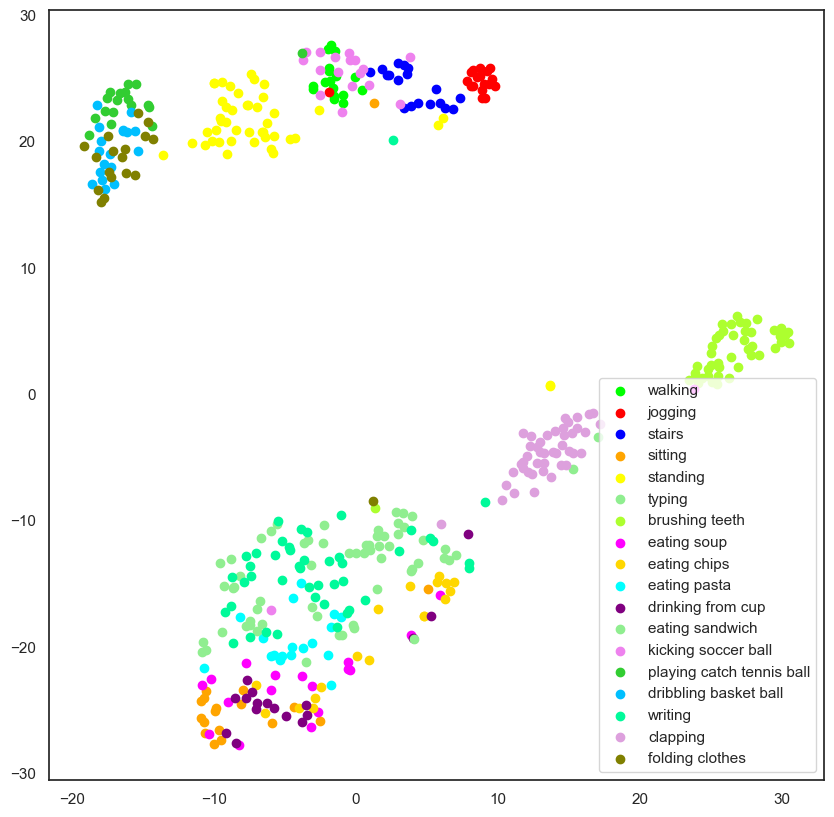

In [78]:
# Define yy as the target labels from the 'ACTIVITY' column of the DataFrame par_23_df
yy = par_23_df.ACTIVITY

# Define XX as the input features obtained by dropping specified columns from par_23_df
# Columns dropped: 'ACTIVITY', 'PARTICIPANT', 'ACT', 'XSTANDDEV', 'YSTANDDEV', 'ZSTANDDEV', 'XVAR', 'YVAR', 'ZVAR'
XX = par_23_df.drop(['ACTIVITY','PARTICIPANT','ACT','XSTANDDEV','YSTANDDEV','ZSTANDDEV','XVAR','YVAR','ZVAR'], axis=1)

# Call the plot_tSNE function with the input features XX, target labels yy, and a figure size of 10
plot_tSNE(XX, yy, 10)

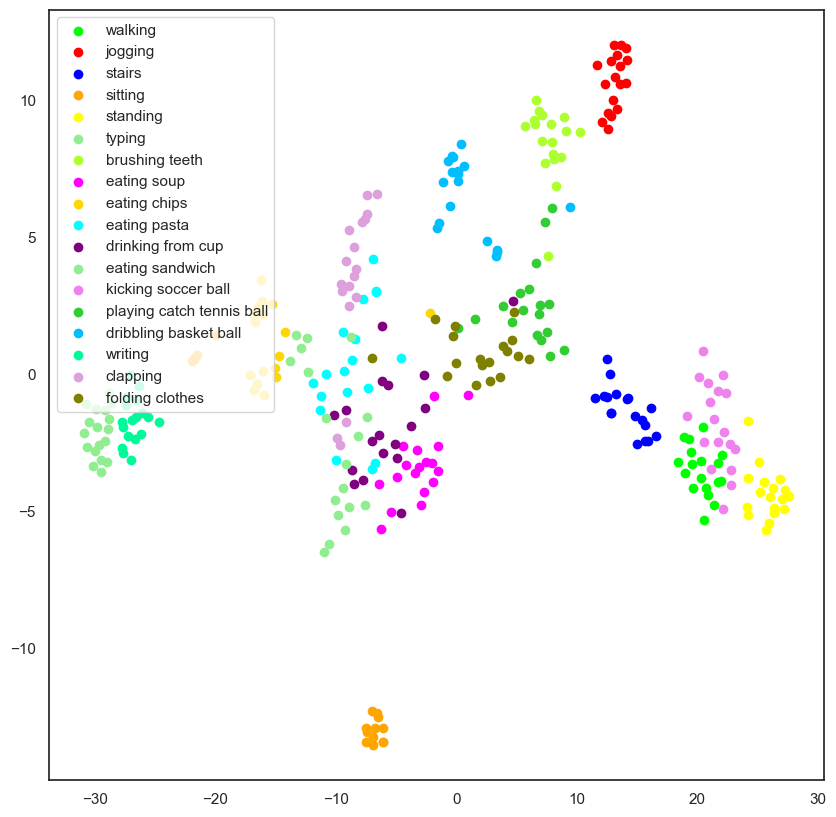

In [79]:
# Define yy as the target labels from the 'ACTIVITY' column of the DataFrame par_40_df
yy = par_40_df.ACTIVITY

# Define XX as the input features obtained by dropping specified columns from par_40_df
# Columns dropped: 'ACTIVITY', 'PARTICIPANT', 'ACT', 'XSTANDDEV', 'YSTANDDEV', 'ZSTANDDEV', 'XVAR', 'YVAR', 'ZVAR'
XX = par_40_df.drop(['ACTIVITY','PARTICIPANT','ACT','XSTANDDEV','YSTANDDEV','ZSTANDDEV','XVAR','YVAR','ZVAR'], axis=1)

# Call the plot_tSNE function with the input features XX, target labels yy, and a figure size of 10
plot_tSNE(XX, yy, 10)


# Machine learning classification models

# Decision Tree classification model

In [80]:
def visualize_tree(model, md=5, width=800):
    """
    Visualizes a decision tree model.

    Parameters:
    - model: Trained decision tree model.
    - md: Maximum depth of the tree (default=5).
    - width: Width of the generated image (default=800).

    Returns:
    - Image: Visualization of the decision tree.
    """

    # Initialize a StringIO object to store DOT data
    dot_data = StringIO()  

    # Export the decision tree to DOT format
    export_graphviz(model, out_file=dot_data, feature_names=X_train.columns, max_depth=md)

    # Convert DOT data to a graph using pydot
    graph = pydot.graph_from_dot_data(dot_data.getvalue())[0]  

    # Create an image representation of the graph and return it
    return Image(graph.create_png(), width=width)


In [81]:
# Import required libraries
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import StratifiedShuffleSplit
from sklearn.model_selection import GroupKFold

my_cv = StratifiedShuffleSplit(n_splits=5, train_size=0.7, test_size=0.3)

In [82]:
dt_classifier = DecisionTreeClassifier()

In [83]:
my_param_grid = {'min_samples_leaf': [6, 10, 20, 40],
                 'min_weight_fraction_leaf': [0.01, 0.02, 0.05],
                 'criterion': ['entropy'],
                 'min_impurity_decrease': [1e-2, 7e-3]}

In [84]:
dt_model_gs = GridSearchCV(estimator=dt_classifier, 
                           param_grid=my_param_grid, 
                           cv=my_cv, 
                           scoring='accuracy',
                           verbose = 0,
                           return_train_score = True)

In [85]:
dt_model_gs.fit(X_train, y_train)

GridSearchCV(cv=StratifiedShuffleSplit(n_splits=5, random_state=None, test_size=0.3,
            train_size=0.7),
             estimator=DecisionTreeClassifier(),
             param_grid={'criterion': ['entropy'],
                         'min_impurity_decrease': [0.01, 0.007],
                         'min_samples_leaf': [6, 10, 20, 40],
                         'min_weight_fraction_leaf': [0.01, 0.02, 0.05]},
             return_train_score=True, scoring='accuracy')

In [86]:
dt_model_gs.best_params_

{'criterion': 'entropy',
 'min_impurity_decrease': 0.007,
 'min_samples_leaf': 6,
 'min_weight_fraction_leaf': 0.01}

In [87]:
dt_best_classifier = dt_model_gs.best_estimator_

In [88]:
dt_best_classifier.get_params()

{'ccp_alpha': 0.0,
 'class_weight': None,
 'criterion': 'entropy',
 'max_depth': None,
 'max_features': None,
 'max_leaf_nodes': None,
 'min_impurity_decrease': 0.007,
 'min_samples_leaf': 6,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.01,
 'random_state': None,
 'splitter': 'best'}

In [89]:
dt_best_classifier.get_depth()

9

In [90]:
dt_best_classifier.get_n_leaves()

54

In [91]:
scores = cross_val_score(dt_best_classifier, X_train, y_train, cv=my_cv, scoring='accuracy')
list(scores)

[0.3489022815325011,
 0.3519156263452432,
 0.3426603529918209,
 0.35040895393887217,
 0.34438226431338786]

In [92]:
dt_best_classifier.score(X_train, y_train)

0.36728235598036685

In [93]:
y_train_pred = dt_best_classifier.predict(X_train)

In [94]:
accuracy_score(y_true=y_train, y_pred=y_train_pred)

0.36728235598036685

In [95]:
log_loss(y_train, dt_best_classifier.predict_proba(X_train))

1.7698185267136566

In [96]:
y_test

0       I
1       Q
2       L
3       B
4       I
       ..
5158    G
5159    A
5160    B
5161    E
5162    G
Name: ACTIVITY, Length: 5163, dtype: object

In [97]:
y_test_pred = dt_best_classifier.predict(X_test)
print(pd.DataFrame(y_test_pred))

      0
0     L
1     F
2     L
3     B
4     S
...  ..
5158  H
5159  A
5160  B
5161  E
5162  F

[5163 rows x 1 columns]


In [98]:
# Compute the confusion matrix using true labels y_test and predicted labels y_test_pred
cm = confusion_matrix(y_true=y_test, y_pred=y_test_pred)

# Create a DataFrame cm_act from the confusion matrix, with activity names as index and columns
cm_act = pd.DataFrame(cm,
                      index=dt_best_classifier.classes_,
                      columns=dt_best_classifier.classes_)

# Rename the index and columns of cm_act using activity names from activity_codes_mapping
cm_act.columns = activity_codes_mapping.values()
cm_act.index = activity_codes_mapping.values()

# Display the confusion matrix
cm_act

,walking,jogging,stairs,sitting,standing,typing,brushing teeth,eating soup,eating chips,eating pasta,drinking from cup,eating sandwich,kicking soccer ball,playing catch tennis ball,dribbling basket ball,writing,clapping,folding clothes
walking,178,7,76,0,0,0,0,0,0,0,3,0,10,0,8,0,0,10
jogging,15,265,7,0,0,0,0,1,0,0,0,0,0,0,0,0,0,11
stairs,55,7,130,0,0,0,0,0,0,0,0,0,44,0,25,0,0,7
sitting,7,1,1,93,8,27,17,24,54,4,1,23,2,2,2,8,8,7
standing,0,0,1,4,147,21,26,0,13,0,4,13,2,7,0,7,0,49
typing,0,2,0,30,11,91,1,10,31,1,8,8,0,3,3,43,16,10
brushing teeth,4,0,4,10,25,23,62,42,18,4,5,14,2,6,4,13,29,29
eating soup,1,0,1,17,12,18,7,84,34,9,22,20,1,9,3,15,16,17
eating chips,3,0,0,13,20,14,8,49,74,10,9,26,0,5,2,10,28,11
eating pasta,1,0,0,18,18,36,2,44,31,10,11,15,1,21,3,14,36,8


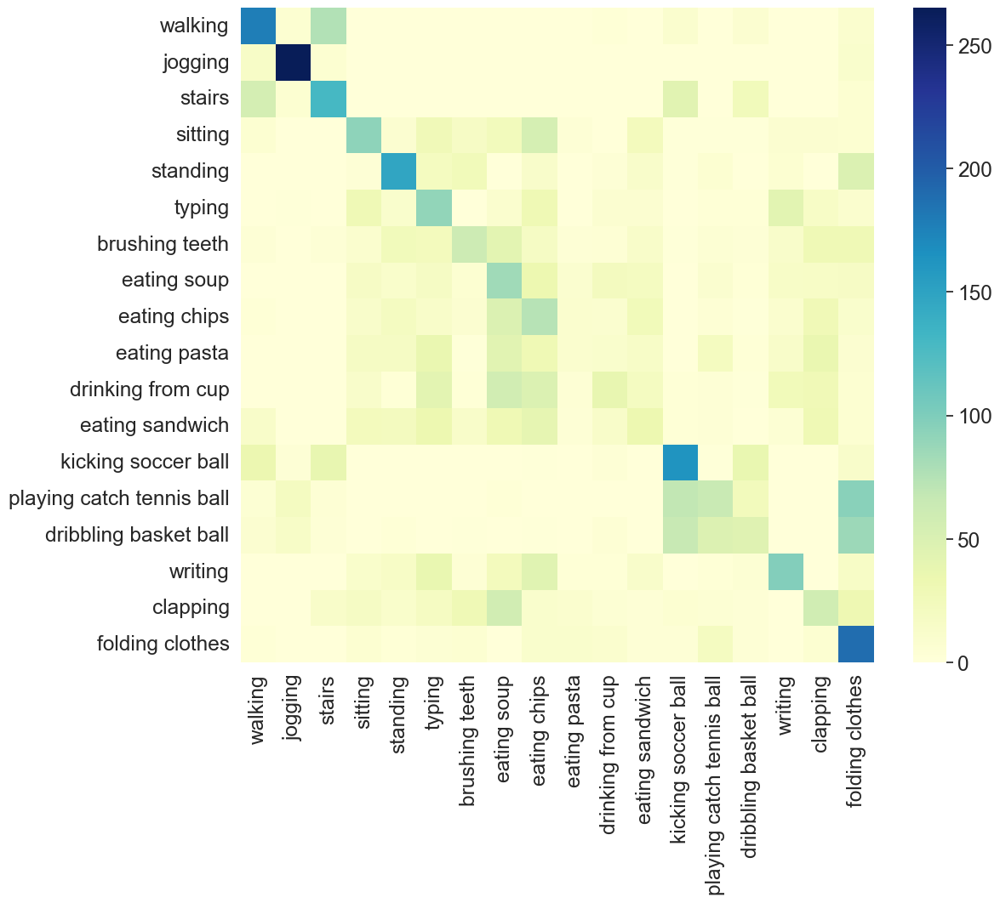

In [99]:
# Set the font scale for seaborn plots
sns.set(font_scale=1.6)

# Create a subplot with a figure size of (12, 10)
fig, ax = plt.subplots(figsize=(12,10))   

# Plot the heatmap of the confusion matrix cm_act using seaborn's heatmap function
_ = sns.heatmap(cm_act, cmap="YlGnBu")

In [100]:
# Calculate the accuracy per activity from the confusion matrix cm_act
# Iterate through each row of cm_act and compute the accuracy for each activity
accuracy_per_activity = pd.DataFrame([cm_act.iloc[i][i] / np.sum(cm_act.iloc[i]) for i in range(18)], index=activity_codes_mapping.values())

# Display the accuracy per activity DataFrame
accuracy_per_activity

,0
walking,0.609589
jogging,0.886288
stairs,0.485075
sitting,0.321799
standing,0.500000
typing,0.339552
brushing teeth,0.210884
eating soup,0.293706
eating chips,0.262411
eating pasta,0.037175


In [101]:
print(classification_report(y_true=y_test,
                            y_pred=y_test_pred))

              precision    recall  f1-score   support

           A       0.54      0.61      0.57       292
           B       0.82      0.89      0.85       299
           C       0.46      0.49      0.47       268
           D       0.36      0.32      0.34       289
           E       0.49      0.50      0.49       294
           F       0.25      0.34      0.29       268
           G       0.34      0.21      0.26       294
           H       0.20      0.29      0.24       286
           I       0.18      0.26      0.21       282
           J       0.14      0.04      0.06       269
           K       0.27      0.13      0.17       301
           L       0.18      0.12      0.14       283
           M       0.43      0.55      0.48       299
           O       0.32      0.22      0.26       290
           P       0.27      0.16      0.20       287
           Q       0.41      0.35      0.37       283
           R       0.23      0.20      0.21       291
           S       0.31    

In [102]:
accuracy_score(y_true=y_test, y_pred=y_test_pred)

0.3536703466976564

In [103]:
log_loss(y_test, dt_best_classifier.predict_proba(X_test))

2.041062620781182

# Random Forest Classification Model

In [104]:
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import StratifiedShuffleSplit
from sklearn.model_selection import GroupKFold
from sklearn.ensemble import RandomForestClassifier

In [105]:
rf_classifier = RandomForestClassifier(**dt_model_gs.best_params_)

In [106]:
my_param_grid = {'bootstrap': [True], 
                 'n_estimators': [50, 100, 200], 
                 'oob_score': [True, False], 
                 'warm_start': [True, False]}

In [107]:
rf_model_gs = GridSearchCV(estimator = rf_classifier, 
                           param_grid = my_param_grid, 
                           scoring = 'accuracy',
                           cv = my_cv)

In [108]:
rf_model_gs.fit(X_train, y_train)

GridSearchCV(cv=StratifiedShuffleSplit(n_splits=5, random_state=None, test_size=0.3,
            train_size=0.7),
             estimator=RandomForestClassifier(criterion='entropy',
                                              min_impurity_decrease=0.007,
                                              min_samples_leaf=6,
                                              min_weight_fraction_leaf=0.01),
             param_grid={'bootstrap': [True], 'n_estimators': [50, 100, 200],
                         'oob_score': [True, False],
                         'warm_start': [True, False]},
             scoring='accuracy')

In [109]:
rf_best_classifier = rf_model_gs.best_estimator_

In [110]:
rf_best_classifier.get_params()

{'bootstrap': True,
 'ccp_alpha': 0.0,
 'class_weight': None,
 'criterion': 'entropy',
 'max_depth': None,
 'max_features': 'sqrt',
 'max_leaf_nodes': None,
 'max_samples': None,
 'min_impurity_decrease': 0.007,
 'min_samples_leaf': 6,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.01,
 'n_estimators': 100,
 'n_jobs': None,
 'oob_score': True,
 'random_state': None,
 'verbose': 0,
 'warm_start': False}

In [111]:
scores = cross_val_score(rf_best_classifier, X_train, y_train, cv=my_cv, scoring='accuracy')
list(scores)

[0.45867412828239346,
 0.4662074903142488,
 0.47051226861816614,
 0.45566078346965133,
 0.45264743865690915]

In [112]:
y_train_pred = rf_best_classifier.predict(X_train)
#print(pd.DataFrame(y_train_pred))

In [113]:
accuracy_score(y_true=y_train, y_pred=y_train_pred)

0.48863342805476623

In [114]:
log_loss(y_train, dt_best_classifier.predict_proba(X_train))

1.7698185267136566

In [115]:
y_test_pred = rf_best_classifier.predict(X_test)
print(pd.DataFrame(y_test_pred))

      0
0     H
1     Q
2     I
3     B
4     S
...  ..
5158  G
5159  A
5160  A
5161  E
5162  G

[5163 rows x 1 columns]


In [116]:
# Compute the confusion matrix using true labels y_test and predicted labels y_test_pred
cm = confusion_matrix(y_true=y_test, y_pred=y_test_pred)

# Create a DataFrame cm_act from the confusion matrix, with activity names as index and columns
cm_act = pd.DataFrame(cm,
                      index=rf_best_classifier.classes_,
                      columns=rf_best_classifier.classes_)

# Rename the index and columns of cm_act using activity names from activity_codes_mapping
cm_act.columns = activity_codes_mapping.values()
cm_act.index = activity_codes_mapping.values()

# Display the confusion matrix
cm_act

,walking,jogging,stairs,sitting,standing,typing,brushing teeth,eating soup,eating chips,eating pasta,drinking from cup,eating sandwich,kicking soccer ball,playing catch tennis ball,dribbling basket ball,writing,clapping,folding clothes
walking,173,23,75,0,0,0,0,0,0,0,0,0,18,0,1,0,0,2
jogging,22,271,4,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1
stairs,82,18,123,0,0,0,0,0,0,0,0,0,33,3,7,0,0,2
sitting,5,1,4,100,23,15,11,11,5,3,45,2,5,0,1,27,21,10
standing,1,0,0,3,226,0,3,0,9,4,1,0,2,5,3,0,0,37
typing,1,0,0,9,32,86,3,8,19,5,30,3,1,4,3,42,6,16
brushing teeth,2,0,3,1,42,3,106,4,10,4,15,1,13,2,5,13,39,31
eating soup,1,0,0,29,31,6,18,62,10,5,41,13,3,2,7,5,20,33
eating chips,0,0,1,7,27,3,15,6,92,23,27,3,4,1,3,18,31,21
eating pasta,0,0,0,27,19,4,14,10,11,81,26,4,3,2,3,14,33,18


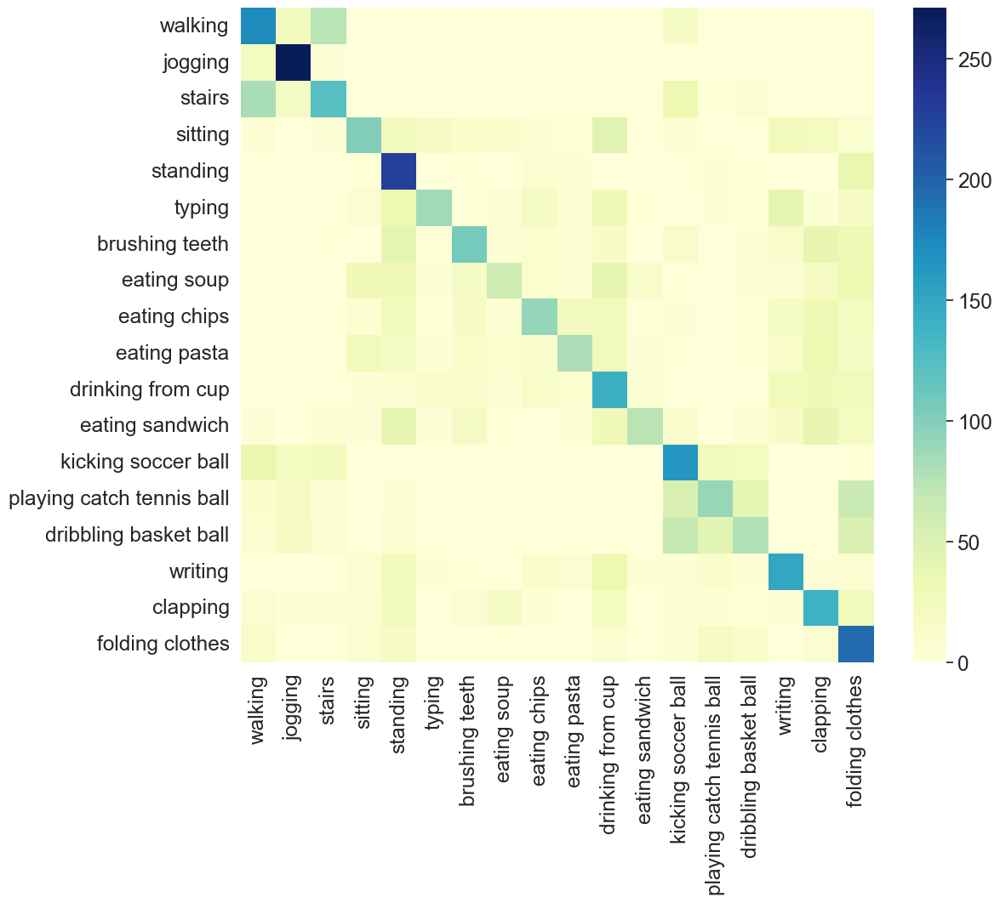

In [117]:
# Set the font scale for seaborn plots
sns.set(font_scale=1.6)

# Create a subplot with a figure size of (12, 10)
fig, ax = plt.subplots(figsize=(12,10))   

# Plot the heatmap of the confusion matrix cm_act using seaborn's heatmap function
_ = sns.heatmap(cm_act, cmap="YlGnBu")

In [118]:
# Calculate the accuracy per activity from the confusion matrix cm_act
# Iterate through each row of cm_act and compute the accuracy for each activity
accuracy_per_activity = pd.DataFrame([cm_act.iloc[i][i] / np.sum(cm_act.iloc[i]) for i in range(18)], index=activity_codes_mapping.values())

# Display the accuracy per activity DataFrame
accuracy_per_activity

,0
walking,0.592466
jogging,0.906355
stairs,0.458955
sitting,0.346021
standing,0.768707
typing,0.320896
brushing teeth,0.360544
eating soup,0.216783
eating chips,0.326241
eating pasta,0.301115


In [119]:
print(classification_report(y_true=y_test,
                            y_pred=y_test_pred))

              precision    recall  f1-score   support

           A       0.47      0.59      0.52       292
           B       0.71      0.91      0.80       299
           C       0.47      0.46      0.46       268
           D       0.48      0.35      0.40       289
           E       0.43      0.77      0.55       294
           F       0.63      0.32      0.42       268
           G       0.50      0.36      0.42       294
           H       0.49      0.22      0.30       286
           I       0.49      0.33      0.39       282
           J       0.54      0.30      0.39       269
           K       0.34      0.47      0.39       301
           L       0.65      0.26      0.37       283
           M       0.41      0.55      0.47       299
           O       0.42      0.31      0.36       290
           P       0.39      0.28      0.32       287
           Q       0.47      0.53      0.50       283
           R       0.37      0.48      0.42       291
           S       0.34    

In [120]:
accuracy_score(y_true=y_test, y_pred=y_test_pred)

0.45516172767770674

In [121]:
log_loss(y_test, dt_best_classifier.predict_proba(X_test))

2.041062620781182

# Logistic regression model

In [122]:
from sklearn.linear_model import LogisticRegression
import warnings

warnings.filterwarnings('ignore')
#%matplotlib inline

In [123]:
lr_classifier = LogisticRegression(verbose = 0)

In [124]:
my_param_grid = {'C': [10, 50, 100, 200]}

In [125]:
lr_model_gs = GridSearchCV(estimator=lr_classifier, 
                           param_grid=my_param_grid, 
                           cv=my_cv, 
                           scoring = 'accuracy')

In [126]:
lr_model_gs.fit(X_train, y_train)

GridSearchCV(cv=StratifiedShuffleSplit(n_splits=5, random_state=None, test_size=0.3,
            train_size=0.7),
             estimator=LogisticRegression(),
             param_grid={'C': [10, 50, 100, 200]}, scoring='accuracy')

In [127]:
lr_best_classifier = lr_model_gs.best_estimator_

In [128]:
lr_best_classifier.get_params()

{'C': 10,
 'class_weight': None,
 'dual': False,
 'fit_intercept': True,
 'intercept_scaling': 1,
 'l1_ratio': None,
 'max_iter': 100,
 'multi_class': 'auto',
 'n_jobs': None,
 'penalty': 'l2',
 'random_state': None,
 'solver': 'lbfgs',
 'tol': 0.0001,
 'verbose': 0,
 'warm_start': False}

In [129]:
scores = cross_val_score(lr_best_classifier, X_train, y_train, cv=my_cv, scoring='accuracy')
list(scores)

[0.36827378390012916,
 0.37300904003443824,
 0.3671975893241498,
 0.3641842445114077,
 0.379896685320706]

In [130]:
y_train_pred=lr_best_classifier.predict(X_train)
#print(pd.DataFrame(y_train_pred))

In [131]:
accuracy_score(y_true=y_train, y_pred=y_train_pred)

0.3822009816584862

In [132]:
log_loss(y_train, lr_best_classifier.predict_proba(X_train))

1.8347562005270155

In [133]:
y_test

0       I
1       Q
2       L
3       B
4       I
       ..
5158    G
5159    A
5160    B
5161    E
5162    G
Name: ACTIVITY, Length: 5163, dtype: object

In [134]:
y_test_pred = lr_best_classifier.predict(X_test)
print(pd.DataFrame(y_test_pred))

      0
0     J
1     Q
2     D
3     B
4     L
...  ..
5158  G
5159  A
5160  B
5161  E
5162  G

[5163 rows x 1 columns]


In [135]:
# Compute the confusion matrix using true labels y_test and predicted labels y_test_pred
cm = confusion_matrix(y_true=y_test, y_pred=y_test_pred)

# Create a DataFrame cm_act from the confusion matrix, with activity names as index and columns
cm_act = pd.DataFrame(cm,
                      index=lr_best_classifier.classes_,
                      columns=lr_best_classifier.classes_)

# Rename the index and columns of cm_act using activity names from activity_codes_mapping
cm_act.columns = activity_codes_mapping.values()
cm_act.index = activity_codes_mapping.values()

# Display the confusion matrix
cm_act

,walking,jogging,stairs,sitting,standing,typing,brushing teeth,eating soup,eating chips,eating pasta,drinking from cup,eating sandwich,kicking soccer ball,playing catch tennis ball,dribbling basket ball,writing,clapping,folding clothes
walking,203,5,56,0,0,0,0,0,0,0,1,0,16,5,1,0,2,3
jogging,10,273,11,2,0,0,0,0,0,0,0,0,0,0,3,0,0,0
stairs,35,4,153,0,0,0,1,0,0,0,0,1,31,13,24,0,3,3
sitting,5,0,1,89,16,10,20,16,9,15,22,20,1,0,1,31,22,11
standing,0,0,1,3,201,6,10,0,15,4,0,6,1,3,13,5,6,20
typing,1,1,0,8,33,23,23,13,37,22,51,11,0,2,0,31,6,6
brushing teeth,0,0,7,22,19,4,79,12,7,8,29,12,0,9,9,15,24,38
eating soup,1,0,0,22,37,19,29,33,32,17,43,16,0,0,1,9,14,13
eating chips,0,0,0,12,17,23,25,19,74,28,33,15,1,0,0,14,14,7
eating pasta,0,0,1,26,13,15,22,21,37,19,39,28,0,2,0,19,17,10


<Axes: >

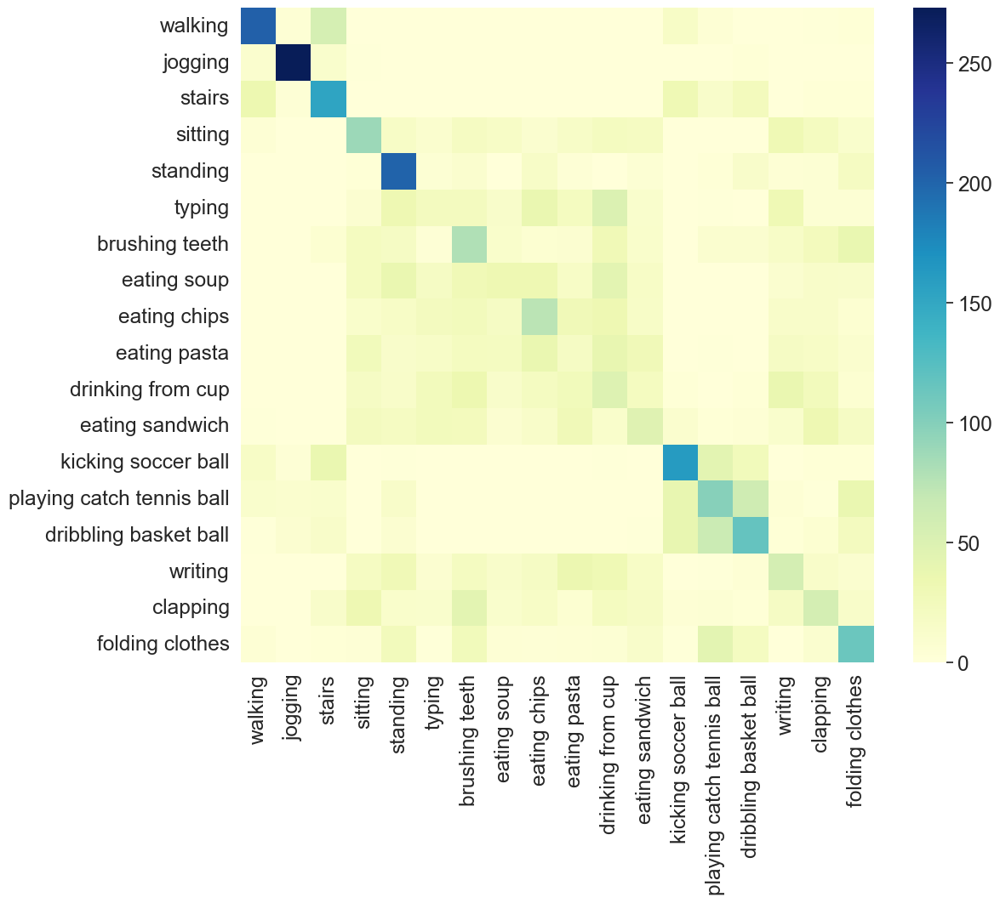

In [136]:
# Set the font scale for seaborn plots
sns.set(font_scale=1.6)

# Create a subplot with a figure size of (12, 10)
fig, ax = plt.subplots(figsize=(12,10))   

# Plot the heatmap of the confusion matrix cm_act using seaborn's heatmap function
sns.heatmap(cm_act, cmap="YlGnBu", ax=ax)

In [137]:
# Calculate the accuracy per activity from the confusion matrix cm_act
# Iterate through each row of cm_act and compute the accuracy for each activity
accuracy_per_activity = pd.DataFrame([cm_act.iloc[i][i] / np.sum(cm_act.iloc[i]) for i in range(18)], index=activity_codes_mapping.values())

# Display the accuracy per activity DataFrame
accuracy_per_activity

,0
walking,0.695205
jogging,0.913043
stairs,0.570896
sitting,0.307958
standing,0.683673
typing,0.085821
brushing teeth,0.268707
eating soup,0.115385
eating chips,0.262411
eating pasta,0.070632


In [138]:
print(classification_report(y_true=y_test,
                            y_pred=y_test_pred))

              precision    recall  f1-score   support

           A       0.69      0.70      0.69       292
           B       0.89      0.91      0.90       299
           C       0.49      0.57      0.53       268
           D       0.31      0.31      0.31       289
           E       0.44      0.68      0.53       294
           F       0.13      0.09      0.10       268
           G       0.22      0.27      0.24       294
           H       0.20      0.12      0.15       286
           I       0.26      0.26      0.26       282
           J       0.09      0.07      0.08       269
           K       0.14      0.16      0.15       301
           L       0.21      0.17      0.18       283
           M       0.52      0.54      0.53       299
           O       0.34      0.34      0.34       290
           P       0.40      0.41      0.40       287
           Q       0.22      0.20      0.21       283
           R       0.22      0.20      0.21       291
           S       0.34    

In [139]:
accuracy_score(y_true=y_test, y_pred=y_test_pred)

0.357931435212086

In [140]:
log_loss(y_test, lr_best_classifier.predict_proba(X_test))

1.8920717014358859

# K Nearset Neighbors Model 

In [141]:
from sklearn.neighbors import KNeighborsClassifier

In [142]:
knn_classifier = KNeighborsClassifier()

In [143]:
my_param_grid = {'n_neighbors': [5, 10, 20], 'leaf_size': [20, 30, 40]}

In [144]:
knn_model_gs = GridSearchCV(estimator = knn_classifier, 
                            param_grid = my_param_grid,
                            cv = my_cv, 
                            scoring ='accuracy')

In [145]:
knn_model_gs.fit(X_train, y_train)

GridSearchCV(cv=StratifiedShuffleSplit(n_splits=5, random_state=None, test_size=0.3,
            train_size=0.7),
             estimator=KNeighborsClassifier(),
             param_grid={'leaf_size': [20, 30, 40], 'n_neighbors': [5, 10, 20]},
             scoring='accuracy')

In [146]:
knn_best_classifier = knn_model_gs.best_estimator_

In [147]:
print(knn_model_gs.best_params_)

{'leaf_size': 20, 'n_neighbors': 5}


In [148]:
knn_best_classifier.get_params()

{'algorithm': 'auto',
 'leaf_size': 20,
 'metric': 'minkowski',
 'metric_params': None,
 'n_jobs': None,
 'n_neighbors': 5,
 'p': 2,
 'weights': 'uniform'}

In [149]:
scores = cross_val_score(knn_best_classifier, X_train, y_train, cv=my_cv, scoring='accuracy')
list(scores)

[nan, nan, nan, nan, nan]

In [150]:
accuracy_score(y_true=y_train, y_pred=y_train_pred)

0.3822009816584862

In [151]:
# Compute the confusion matrix using true labels y_test and predicted labels y_test_pred
cm = confusion_matrix(y_true=y_test, y_pred=y_test_pred)

# Create a DataFrame cm_act from the confusion matrix, with activity names as index and columns
cm_act = pd.DataFrame(cm,
                      index=knn_best_classifier.classes_,
                      columns=knn_best_classifier.classes_)

# Rename the index and columns of cm_act using activity names from activity_codes_mapping
cm_act.columns = activity_codes_mapping.values()
cm_act.index = activity_codes_mapping.values()

# Display the confusion matrix
cm_act

,walking,jogging,stairs,sitting,standing,typing,brushing teeth,eating soup,eating chips,eating pasta,drinking from cup,eating sandwich,kicking soccer ball,playing catch tennis ball,dribbling basket ball,writing,clapping,folding clothes
walking,203,5,56,0,0,0,0,0,0,0,1,0,16,5,1,0,2,3
jogging,10,273,11,2,0,0,0,0,0,0,0,0,0,0,3,0,0,0
stairs,35,4,153,0,0,0,1,0,0,0,0,1,31,13,24,0,3,3
sitting,5,0,1,89,16,10,20,16,9,15,22,20,1,0,1,31,22,11
standing,0,0,1,3,201,6,10,0,15,4,0,6,1,3,13,5,6,20
typing,1,1,0,8,33,23,23,13,37,22,51,11,0,2,0,31,6,6
brushing teeth,0,0,7,22,19,4,79,12,7,8,29,12,0,9,9,15,24,38
eating soup,1,0,0,22,37,19,29,33,32,17,43,16,0,0,1,9,14,13
eating chips,0,0,0,12,17,23,25,19,74,28,33,15,1,0,0,14,14,7
eating pasta,0,0,1,26,13,15,22,21,37,19,39,28,0,2,0,19,17,10


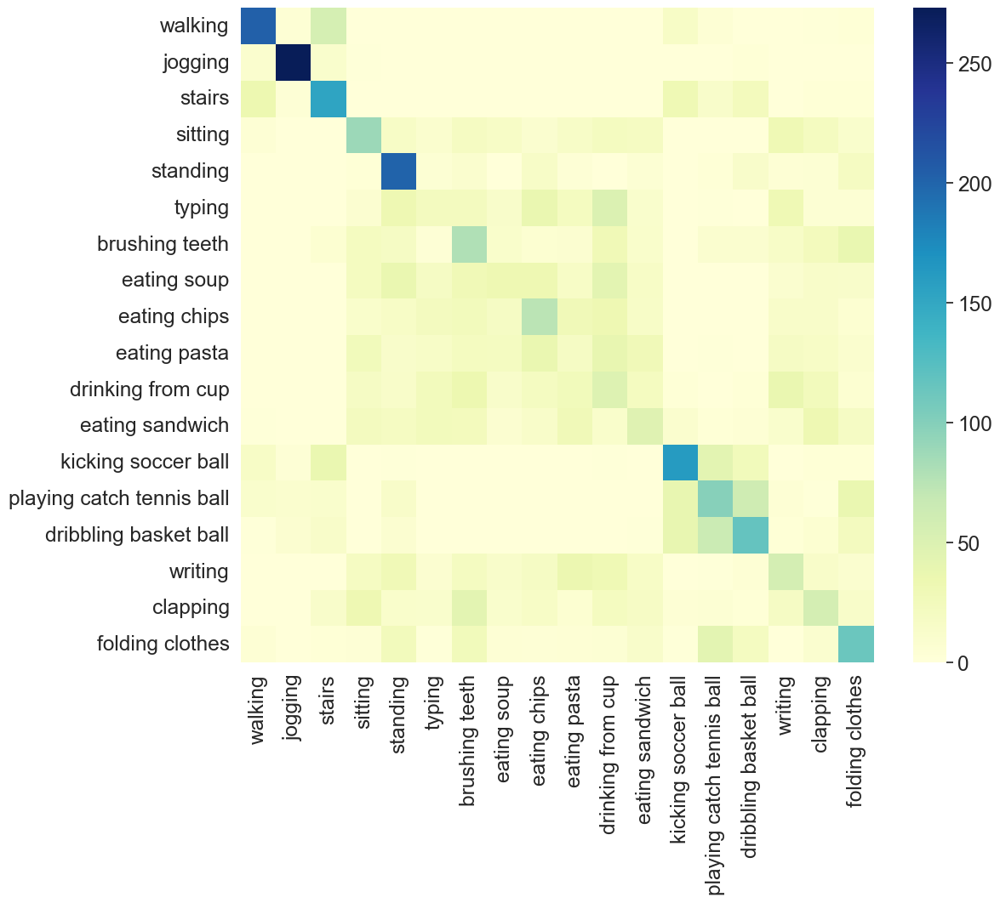

In [152]:
# Set the font scale for seaborn plots
sns.set(font_scale=1.6)

# Create a subplot with a figure size of (12, 10)
fig, ax = plt.subplots(figsize=(12,10))   

# Plot the heatmap of the confusion matrix cm_act using seaborn's heatmap function
_ = sns.heatmap(cm_act, cmap="YlGnBu")

In [153]:
# Calculate the accuracy per activity from the confusion matrix cm_act
# Iterate through each row of cm_act and compute the accuracy for each activity
accuracy_per_activity = pd.DataFrame([cm_act.iloc[i][i] / np.sum(cm_act.iloc[i]) for i in range(18)], index=activity_codes_mapping.values())

# Display the accuracy per activity DataFrame
accuracy_per_activity

,0
walking,0.695205
jogging,0.913043
stairs,0.570896
sitting,0.307958
standing,0.683673
typing,0.085821
brushing teeth,0.268707
eating soup,0.115385
eating chips,0.262411
eating pasta,0.070632


In [154]:
print(classification_report(y_true=y_test,
                            y_pred=y_test_pred))

              precision    recall  f1-score   support

           A       0.69      0.70      0.69       292
           B       0.89      0.91      0.90       299
           C       0.49      0.57      0.53       268
           D       0.31      0.31      0.31       289
           E       0.44      0.68      0.53       294
           F       0.13      0.09      0.10       268
           G       0.22      0.27      0.24       294
           H       0.20      0.12      0.15       286
           I       0.26      0.26      0.26       282
           J       0.09      0.07      0.08       269
           K       0.14      0.16      0.15       301
           L       0.21      0.17      0.18       283
           M       0.52      0.54      0.53       299
           O       0.34      0.34      0.34       290
           P       0.40      0.41      0.40       287
           Q       0.22      0.20      0.21       283
           R       0.22      0.20      0.21       291
           S       0.34    

In [155]:
accuracy_score(y_true = y_test, y_pred = y_test_pred)

0.357931435212086

# Model Accurracy score:

Decision Tree: 0.34

Random Forest:0.46

Logistic Regression:0.37

KNN: 0.37